In [34]:
import sys
def sizeof_fmt(num, suffix='B'):
    ''' by Fred Cirera,  https://stackoverflow.com/a/1094933/1870254, modified'''
    for unit in ['','Ki','Mi','Gi','Ti','Pi','Ei','Zi']:
        if abs(num) < 1024.0:
            return "%3.1f %s%s" % (num, unit, suffix)
        num /= 1024.0
    return "%.1f %s%s" % (num, 'Yi', suffix)

for name, size in sorted(((name, sys.getsizeof(value)) for name, value in locals().items()),
                         key= lambda x: -x[1])[:10]:
    print("{:>30}: {:>8}".format(name, sizeof_fmt(size)))

                            __:  1.3 GiB
                         spots:  1.3 GiB
                           _10:  1.3 GiB
                           stk:  1.0 GiB
                           ___: 711.8 MiB
                            _3: 711.8 MiB
                            _9: 711.8 MiB
               predicted_cells: 65.7 MiB
                             _:  5.3 MiB
            predicted_metadata:  5.3 MiB


In [1]:
from fish_helpers import *

In [126]:
MERFISH = pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/Hippocampus_sham_m3_segmented_data/Merged.Cells.pixel.Coords.csv.gz')
MERFISH

,pos,x,y,z,Sema5a,Ttyh2,Tnfaip8l3,Cacna2d1,Ncan,Spry2,...,Kl,Nes,Myo3a,Sap30bpos,Rassf3,Prox1,Grm2,Casp8,Plekha5,Selplg
X1,Pos1,0,833,10,1,2,1,1,3,1,...,0,0,0,0,0,0,0,0,0,0
X2,Pos1,0,1260,10,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
X3,Pos1,42,1737,10,0,0,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
X4,Pos1,99,1909,10,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
X5,Pos1,12,1545,10,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
X6,Pos1,33,313,10,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
X7,Pos1,81,1338,10,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
X8,Pos1,146,1070,10,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
X9,Pos1,123,0,10,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
X10,Pos1,154,709,10,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# XY were flipped
MERFISH_stage = pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/Hippocampus_sham_m3_segmented_data/Merged.Cells.stage.Coords.csv.gz')
cameradirection=[1,1]
pixelsize = 0.109
index = []
X = []
Y = []
for pos in MERFISH.pos.unique():
    print(pos)
    coordX,coordY = md.image_table[md.image_table.Position==pos].XY.iloc[0]
    pos_temp = MERFISH[MERFISH.pos==pos]
    for i in pos_temp.index:
        index.append(i)
        x = pos_temp.loc[i].x*pixelsize*cameradirection[0]+coordX
        y = pos_temp.loc[i].y*pixelsize*cameradirection[1]+coordY
        X.append(x)
        Y.append(y)
MERFISH_stage['stage_x'] = X
MERFISH_stage['stage_y'] = Y

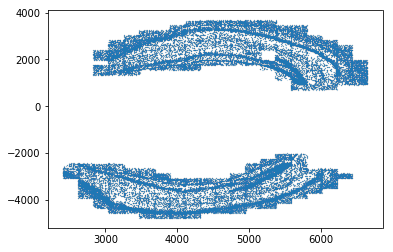

In [477]:
plt.scatter(X,Y,s=0.001)
plt.show()

In [130]:
pos1 = MERFISH[MERFISH.pos=='Pos1']
pos1

,pos,x,y,z,Sema5a,Ttyh2,Tnfaip8l3,Cacna2d1,Ncan,Spry2,...,Kl,Nes,Myo3a,Sap30bpos,Rassf3,Prox1,Grm2,Casp8,Plekha5,Selplg
X1,Pos1,0,833,10,1,2,1,1,3,1,...,0,0,0,0,0,0,0,0,0,0
X2,Pos1,0,1260,10,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
X3,Pos1,42,1737,10,0,0,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
X4,Pos1,99,1909,10,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
X5,Pos1,12,1545,10,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
X6,Pos1,33,313,10,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
X7,Pos1,81,1338,10,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
X8,Pos1,146,1070,10,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
X9,Pos1,123,0,10,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
X10,Pos1,154,709,10,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0


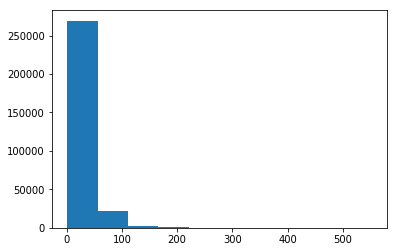

In [336]:
plt.hist(np.sum(MERFISH.drop(columns=['pos','x','y','z']),axis=1))
plt.show()

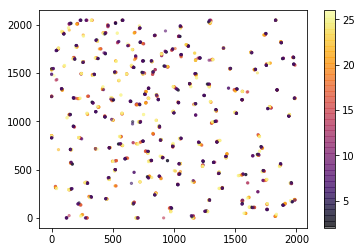

In [137]:
plt.scatter(pos1.x,pos1.y,c=pos1.z,s=5,alpha=0.5,cmap='inferno')
plt.colorbar()
plt.show()

In [7]:
md = Metadata('/hybedata/Images/Robert/TBI_v2/sham_m3_slide4_2019Nov04/')

In [227]:
stk = md.stkread(Position='Pos1',Channel='DeepBlue',acq= [i for i in md.acqnames if 'nucstain' in i])

opening img_Pos1_000000032_000000000_DeepBlue_000_032.tif

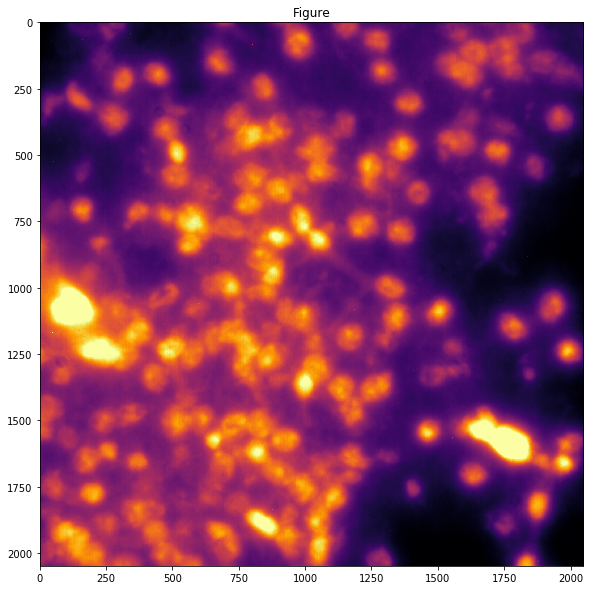

In [228]:
img = np.sum(stk,axis=2)
Display(img)

/home/zach/miniconda3/envs/pyspots/lib/python3.6/site-packages/skimage/util/dtype.py:135: UserWarning: Possible precision loss when converting from uint64 to float64
  .format(dtypeobj_in, dtypeobj_out))


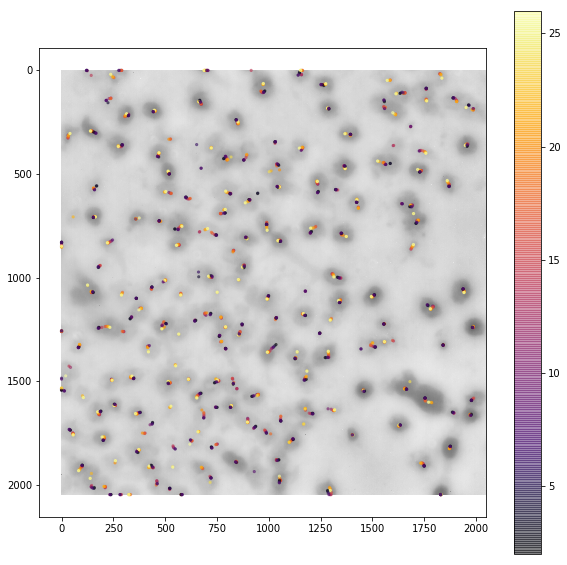

In [229]:
plt.figure(figsize=[10,10])
temp = img/filters.gaussian(img, 100)
# temp = temp-np.percentile(temp.ravel(),5)
# temp = temp/np.percentile(temp.ravel(),99)
plt.imshow(np.log10(temp+1),cmap='Greys')
plt.scatter(pos1.x,pos1.y,c=pos1.z,s=5,alpha=0.5,cmap='inferno')
plt.colorbar()
plt.show()

In [239]:
xy = np.zeros((len(pos1),2))
xy[:,0] = np.array(pos1.x)
xy[:,1] = np.array(pos1.y)
xy

array([[   0.,  833.],
       [   0., 1260.],
       [  42., 1737.],
       ...,
       [1986.,  185.],
       [1974., 1664.],
       [1829., 2047.]])

In [283]:
from sklearn.cluster import AgglomerativeClustering

In [290]:
np.sqrt(2*(10/0.109)**2)

129.74436352046743

opening img_Pos1_000000015_000000000_DeepBlue_000_015.tif

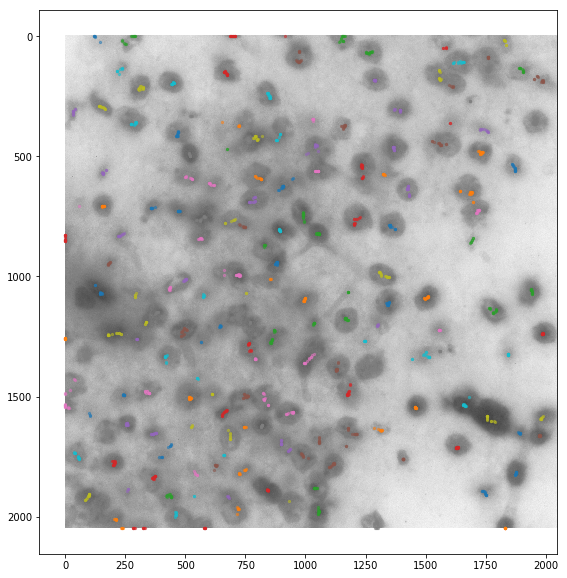

In [569]:
%matplotlib inline
xy = np.zeros((len(pos1),2))
xy[:,0] = np.array(pos1.x)
xy[:,1] = np.array(pos1.y)
thresh = np.sqrt(2*(10/0.109)**2)
clustering = AgglomerativeClustering(n_clusters=None,distance_threshold=thresh).fit(xy)
labels = pd.DataFrame(clustering.labels_,index=pos1.index)
plt.figure(figsize=[10,10])
img = md.stkread(Position='Pos1',Channel='DeepBlue',acq= [i for i in md.acqnames if 'nucstain' in i],Zindex=15)[:,:,0]
plt.imshow(np.log10(img+1),cmap='Greys')
for i in np.unique(clustering.labels_):
    cells = list(labels[labels[0]==i].index)
    temp_df = pos1.loc[cells]
    plt.scatter(temp_df.x,temp_df.y,s=5,alpha=0.5,label=str(i))
# plt.legend()
plt.show()

In [570]:
MERFISH_stage.head()

,x,y,z,Sema5a,Ttyh2,Tnfaip8l3,Cacna2d1,Ncan,Spry2,Epb41l4b,...,Myo3a,Sap30bpos,Rassf3,Prox1,Grm2,Casp8,Plekha5,Selplg,stage_x,stage_y
X1,2320.203,-3087.000,10,1,2,1,1,3,1,1,...,0,0,0,0,0,0,0,0,2411.000,-2996.203
X2,2273.660,-3087.000,10,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,2411.000,-2949.660
X3,2221.667,-3082.422,10,0,0,0,1,1,1,1,...,0,0,0,0,0,0,0,0,2415.578,-2897.667
X4,2202.919,-3076.209,10,0,0,0,0,1,0,2,...,0,0,0,0,0,0,0,0,2421.791,-2878.919
X5,2242.595,-3085.692,10,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,2412.308,-2918.595


In [578]:
# only for 1 hemisphere size limitations
temp_df = MERFISH_stage[MERFISH_stage.stage_y>0]
print(len(temp_df))
xy = np.zeros((len(temp_df),2))
xy[:,0] = np.array(temp_df.stage_x)
xy[:,1] = np.array(temp_df.stage_y)
thresh = np.sqrt(200) #sqrt 10**2 +10**2
clustering = AgglomerativeClustering(n_clusters=None,distance_threshold=thresh).fit(xy)


150763


In [580]:
labels = pd.DataFrame(clustering.labels_,index=temp_df.index)
clustered_MERFISH_stage = pd.DataFrame(index=range(len(np.unique(clustering.labels_))))
non_gene_columns = ['x','y','z','stage_x','stage_y']
gene_columns = [i for i in MERFISH_stage.columns if not i in non_gene_columns]
values_dict = {}
for column in MERFISH_stage.columns:
    values_dict[column] = []
for i in np.unique(clustering.labels_):
    cells = list(labels[labels[0]==i].index)
    for column in non_gene_columns:
        values_dict[column].append(np.average(MERFISH_stage[column].loc[cells]))
    for column in gene_columns:
        values_dict[column].append(np.sum(MERFISH_stage[column].loc[cells]))
for column in MERFISH_stage.columns:
    clustered_MERFISH_stage[column] = values_dict[column]
clustered_MERFISH_stage

,x,y,z,Sema5a,Ttyh2,Tnfaip8l3,Cacna2d1,Ncan,Spry2,Epb41l4b,...,Myo3a,Sap30bpos,Rassf3,Prox1,Grm2,Casp8,Plekha5,Selplg,stage_x,stage_y
0,6014.663727,1107.132364,13.090909,0,0,0,3,5,2,1,...,0,0,0,0,0,0,0,0,6394.132364,1114.336273
1,5106.636071,1767.304571,13.857143,6,1,0,1,12,2,4,...,0,0,0,0,0,0,0,0,5155.304571,1811.363929
2,5027.884769,3434.885846,14.000000,13,7,1,5,18,5,3,...,0,0,0,0,0,0,0,0,5346.885846,3366.115231
3,4555.973250,2721.659750,7.250000,0,0,0,0,13,1,0,...,0,0,0,0,0,1,0,0,4844.659750,2783.026750
4,3711.211867,1850.601333,16.266667,4,2,0,1,21,1,1,...,0,0,2,0,0,0,0,0,3902.601333,1870.788133
5,4720.964769,2819.000000,14.000000,0,7,0,0,10,1,2,...,0,0,0,1,0,0,0,0,4942.000000,3040.035231
6,4775.200933,1920.412200,13.600000,5,1,3,7,12,2,4,...,0,0,0,0,0,0,1,0,5097.412200,1931.799067
7,5644.806071,944.660786,14.714286,1,8,0,2,17,1,6,...,0,0,0,0,1,0,0,5,5809.660786,1062.193929
8,5832.316571,1742.118429,13.142857,0,0,1,2,0,1,2,...,0,0,0,0,0,0,0,0,6185.118429,1718.683429
9,5139.920000,1852.370312,12.500000,10,0,0,15,25,1,9,...,0,0,0,0,1,0,0,0,5240.370312,1778.080000


In [584]:
clustered_MERFISH_stage.to_csv('/bigstore/GeneralStorage/Zach/CSI/Hippocampus_sham_m3_segmented_data/clustered_MERFISH_stage.csv.gz',compression='gzip')

In [ ]:
# only for 1 hemisphere size limitations
temp_df = MERFISH_stage[MERFISH_stage.stage_y<0]
print(len(temp_df))
xy = np.zeros((len(temp_df),2))
xy[:,0] = np.array(temp_df.stage_x)
xy[:,1] = np.array(temp_df.stage_y)
thresh = np.sqrt(200) #sqrt 10**2 +10**2
clustering = AgglomerativeClustering(n_clusters=None,distance_threshold=thresh).fit(xy)
labels = pd.DataFrame(clustering.labels_,index=temp_df.index)
clustered_MERFISH_stage2 = pd.DataFrame(index=range(len(np.unique(clustering.labels_))))
non_gene_columns = ['x','y','z','stage_x','stage_y']
gene_columns = [i for i in MERFISH_stage.columns if not i in non_gene_columns]
values_dict = {}
for column in MERFISH_stage.columns:
    values_dict[column] = []
for i in np.unique(clustering.labels_):
    cells = list(labels[labels[0]==i].index)
    for column in non_gene_columns:
        values_dict[column].append(np.average(MERFISH_stage[column].loc[cells]))
    for column in gene_columns:
        values_dict[column].append(np.sum(MERFISH_stage[column].loc[cells]))
for column in MERFISH_stage.columns:
    clustered_MERFISH_stage2[column] = values_dict[column]
clustered_MERFISH_stage2

143999


In [588]:
clustered_MERFISH_stage2

,x,y,z,Sema5a,Ttyh2,Tnfaip8l3,Cacna2d1,Ncan,Spry2,Epb41l4b,...,Myo3a,Sap30bpos,Rassf3,Prox1,Grm2,Casp8,Plekha5,Selplg,stage_x,stage_y
0,4487.227889,-3189.574444,13.777778,15,20,12,17,35,8,3,...,2,1,3,4,2,0,0,0,4729.018148,-3162.635296
1,2970.922312,-4284.433625,12.500000,1,0,0,5,15,8,1,...,0,0,0,0,0,0,0,0,3111.566375,-4278.922313
2,4240.697875,-4523.276313,12.875000,0,1,0,2,8,0,0,...,0,0,0,0,0,0,0,0,4348.723687,-4494.697875
3,4319.016824,-4525.965647,13.764706,0,13,0,0,0,1,1,...,0,1,3,0,0,0,0,0,4557.034353,-4362.016824
4,3775.238667,-4737.642444,9.111111,0,2,0,0,0,0,1,...,0,0,1,0,0,0,0,0,3923.357556,-4662.238667
5,3388.197357,-4433.103143,14.571429,1,0,1,5,16,4,0,...,0,0,0,0,0,1,0,0,3595.896857,-4485.197357
6,4892.470400,-2455.596467,13.066667,18,0,0,5,6,4,4,...,0,0,1,0,0,1,0,1,5151.403533,-2615.470400
7,4918.058929,-3557.779500,12.000000,0,0,0,1,2,0,0,...,0,0,0,0,0,0,1,2,5118.291929,-3710.130357
8,3306.813286,-3414.656143,10.857143,1,0,0,1,8,0,0,...,0,0,0,0,1,0,0,0,3499.058143,-3288.527571
9,4834.801706,-3258.877176,11.529412,0,0,0,0,4,3,0,...,0,0,0,0,0,0,0,0,5079.416941,-3289.095824


In [587]:
1

1

In [590]:
clustered_MERFISH_stage2.to_csv('/bigstore/GeneralStorage/Zach/CSI/Hippocampus_sham_m3_segmented_data/clustered_MERFISH_stage2.csv.gz',compression='gzip')

In [591]:
A = [clustered_MERFISH_stage,clustered_MERFISH_stage2]
MERFISH_clustered = pd.concat(A,ignore_index=True)
MERFISH_clustered

,x,y,z,Sema5a,Ttyh2,Tnfaip8l3,Cacna2d1,Ncan,Spry2,Epb41l4b,...,Myo3a,Sap30bpos,Rassf3,Prox1,Grm2,Casp8,Plekha5,Selplg,stage_x,stage_y
0,6014.663727,1107.132364,13.090909,0,0,0,3,5,2,1,...,0,0,0,0,0,0,0,0,6394.132364,1114.336273
1,5106.636071,1767.304571,13.857143,6,1,0,1,12,2,4,...,0,0,0,0,0,0,0,0,5155.304571,1811.363929
2,5027.884769,3434.885846,14.000000,13,7,1,5,18,5,3,...,0,0,0,0,0,0,0,0,5346.885846,3366.115231
3,4555.973250,2721.659750,7.250000,0,0,0,0,13,1,0,...,0,0,0,0,0,1,0,0,4844.659750,2783.026750
4,3711.211867,1850.601333,16.266667,4,2,0,1,21,1,1,...,0,0,2,0,0,0,0,0,3902.601333,1870.788133
5,4720.964769,2819.000000,14.000000,0,7,0,0,10,1,2,...,0,0,0,1,0,0,0,0,4942.000000,3040.035231
6,4775.200933,1920.412200,13.600000,5,1,3,7,12,2,4,...,0,0,0,0,0,0,1,0,5097.412200,1931.799067
7,5644.806071,944.660786,14.714286,1,8,0,2,17,1,6,...,0,0,0,0,1,0,0,5,5809.660786,1062.193929
8,5832.316571,1742.118429,13.142857,0,0,1,2,0,1,2,...,0,0,0,0,0,0,0,0,6185.118429,1718.683429
9,5139.920000,1852.370312,12.500000,10,0,0,15,25,1,9,...,0,0,0,0,1,0,0,0,5240.370312,1778.080000


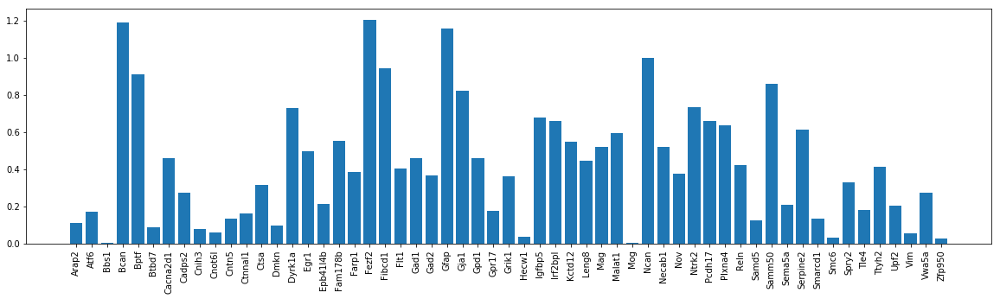

In [625]:
ss2 = np.average(MERFISH_clustered.drop(columns=['x','y','z','stage_x','stage_y']),axis=0)
ss_df = pd.DataFrame(ss2,index=MERFISH_clustered.drop(columns=['x','y','z','stage_x','stage_y']).columns)
ss_df = ss_df.sort_index()
temp = ss_df[ss_df[0]>1]
plt.figure(figsize=[20,5])
plt.bar(temp.index,np.log10(temp[0]))
plt.xticks(rotation='vertical')
plt.show()

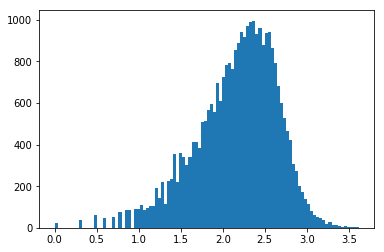

In [607]:
ss = np.sum(MERFISH_clustered.drop(columns=['x','y','z','stage_x','stage_y']),axis=1)
plt.hist(np.log10(ss),bins=100)
plt.show()

In [609]:
np.median(ss)

170.0

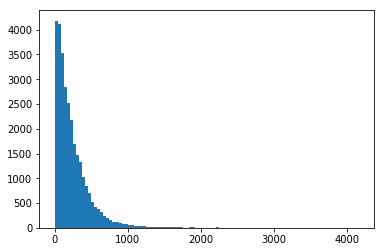

In [608]:
ss = np.sum(MERFISH_clustered.drop(columns=['x','y','z','stage_x','stage_y']),axis=1)
plt.hist(ss,bins=100)
plt.show()

In [592]:
MERFISH_clustered.to_csv('/bigstore/GeneralStorage/Zach/CSI/Hippocampus_sham_m3_segmented_data/MERFISH_clustered.csv.gz',compression='gzip')

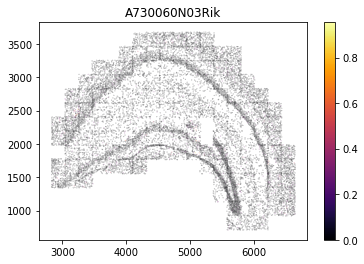

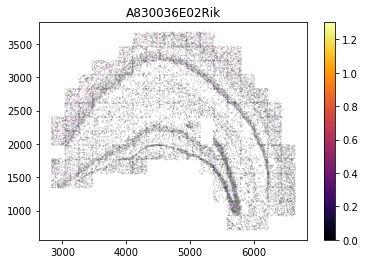

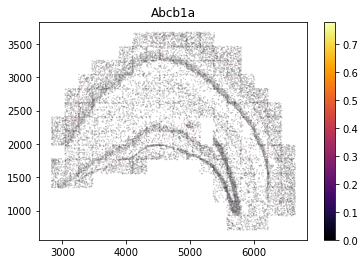

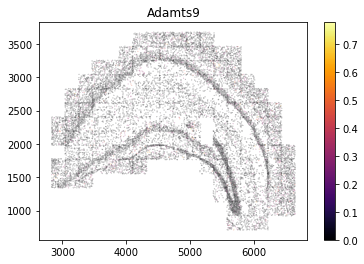

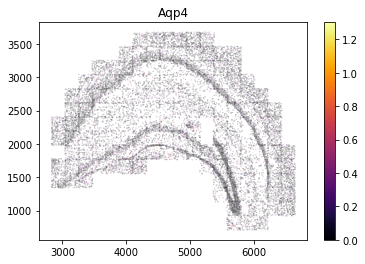

...

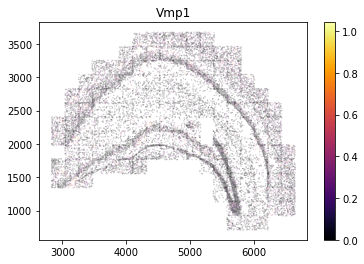

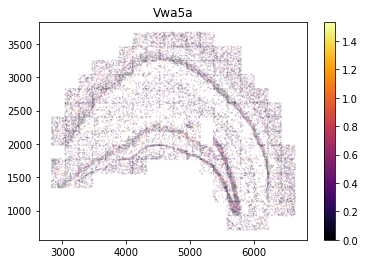

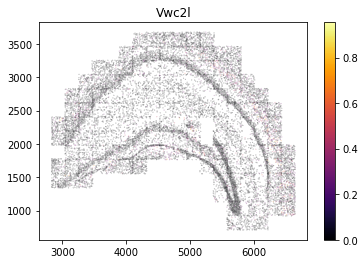

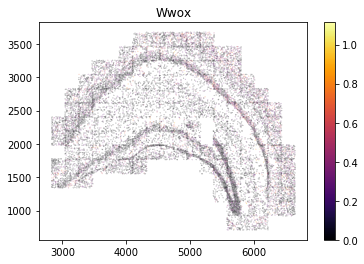

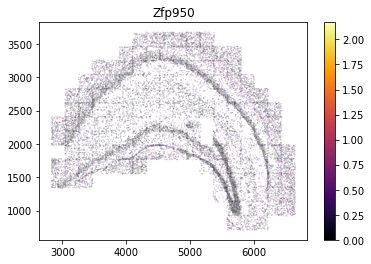

In [610]:
g = gene_columns
g.sort()
for gene in g:
    plt.scatter(clustered_MERFISH_stage.stage_x,clustered_MERFISH_stage.stage_y,c=np.log10(clustered_MERFISH_stage[gene]+1),s=0.01,cmap='inferno')
    plt.colorbar()
    plt.title(gene)
    plt.show()

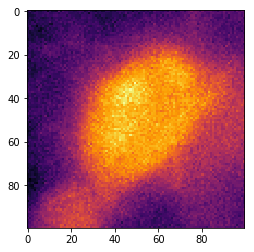

In [174]:
i=30
x = pos1.iloc[i].y
y = pos1.iloc[i].x
r = 50
if x-r < 0:
    x_min = 0
else:
    x_min = x-r
if y-r < 0:
    y_min = 0
else:
    y_min = y-r
cell = img[x_min:x+r,y_min:y+r]
plt.imshow(cell,cmap='inferno')

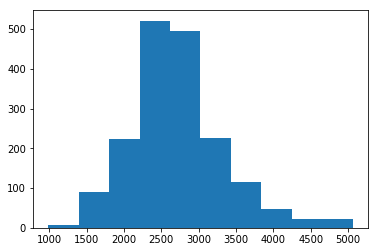

In [175]:
intensity = []
for cell in pos1.index:
    x = pos1.loc[cell].y
    y = pos1.loc[cell].x
    intensity.append(img[x,y])
plt.hist(intensity)
plt.show()

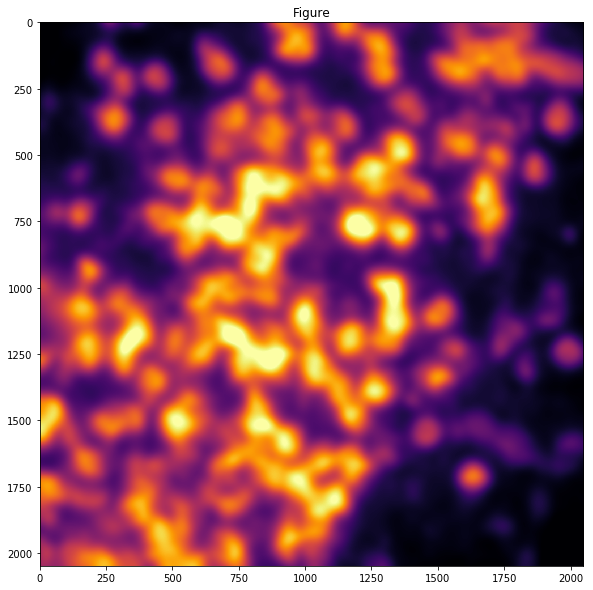

In [181]:
blurred = filters.gaussian(img, 20)
Display(blurred)

opening img_Pos1_000000032_000000000_Orange_000_032.tif

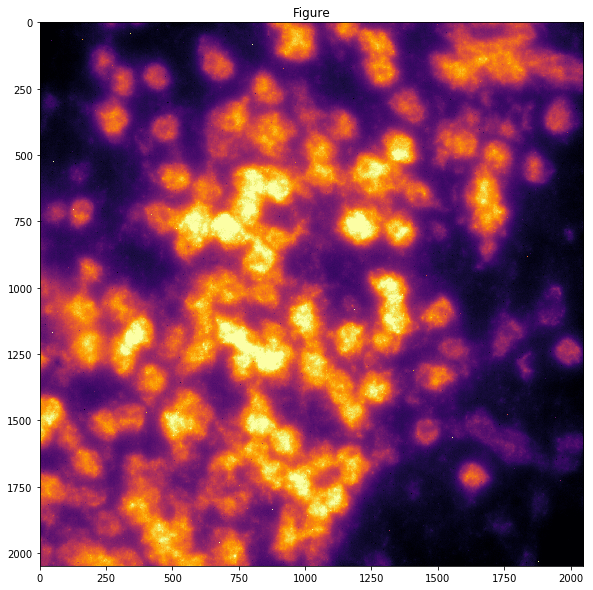

In [309]:
stk = md.stkread(Position='Pos1',Channel=color,acq=acq)
Display(np.sum(stk,axis=2))

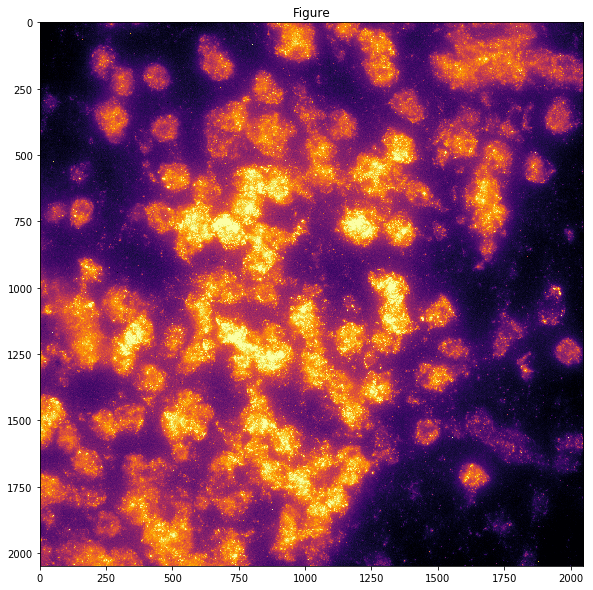

In [310]:
Display(np.max(stk,axis=2))

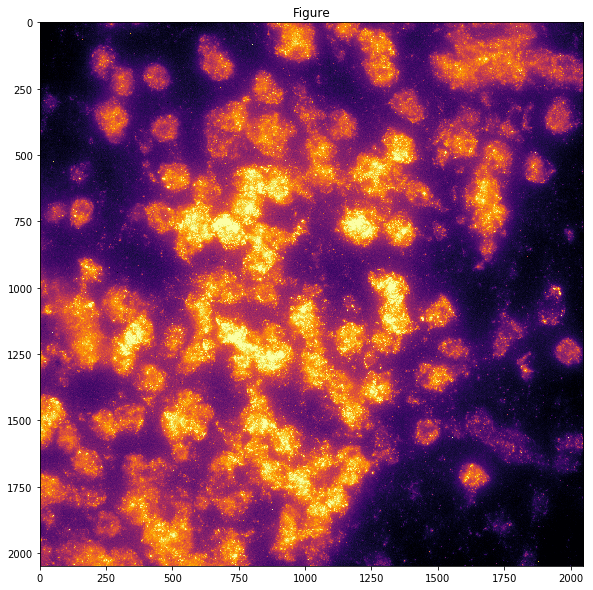

In [318]:
Display(np.max(stk,axis=2))

opening img_Pos1_000000032_000000000_FarRed_000_032.tif

/home/zach/miniconda3/envs/pyspots/lib/python3.6/site-packages/skimage/util/dtype.py:135: UserWarning: Possible precision loss when converting from uint64 to float64
  .format(dtypeobj_in, dtypeobj_out))


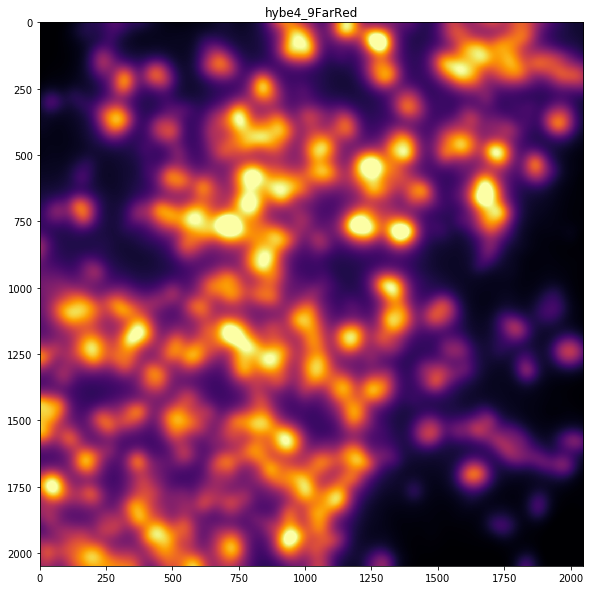

opening img_Pos1_000000032_000000000_Orange_000_032.tif

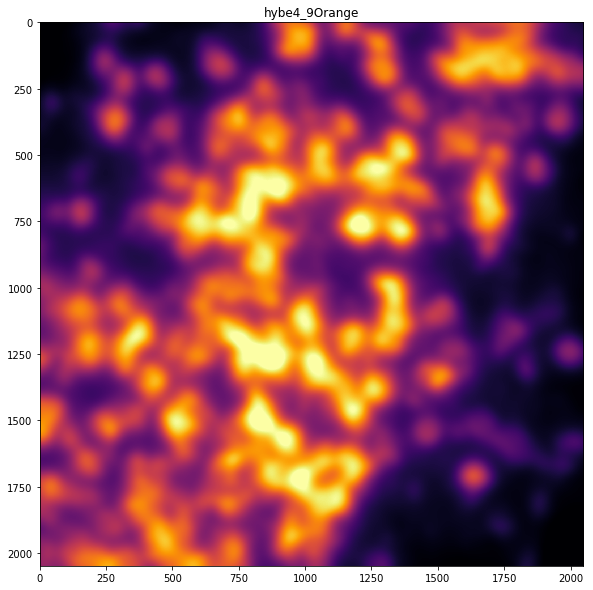

opening img_Pos1_000000032_000000000_FarRed_000_032.tif

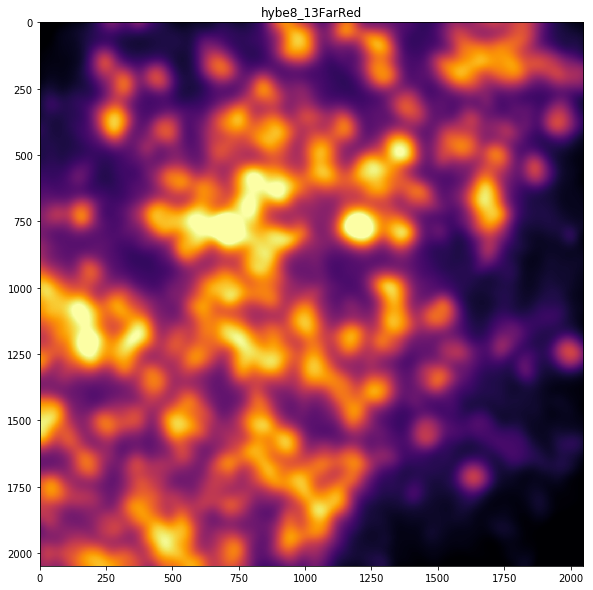

opening img_Pos1_000000032_000000000_Orange_000_032.tif

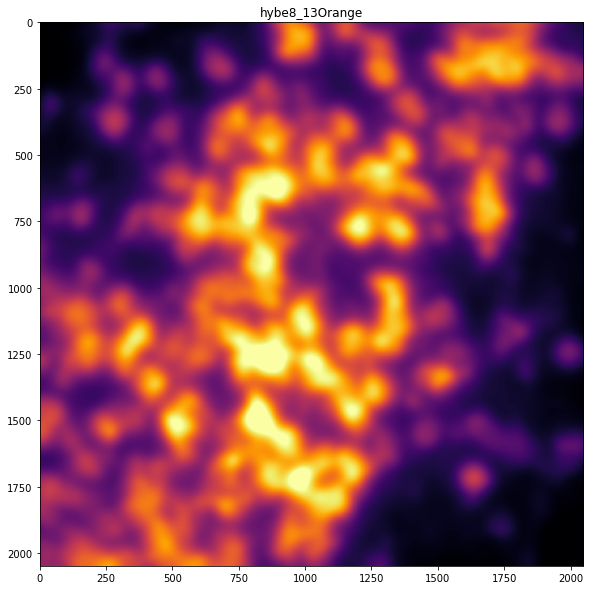

opening img_Pos1_000000032_000000000_FarRed_000_032.tif

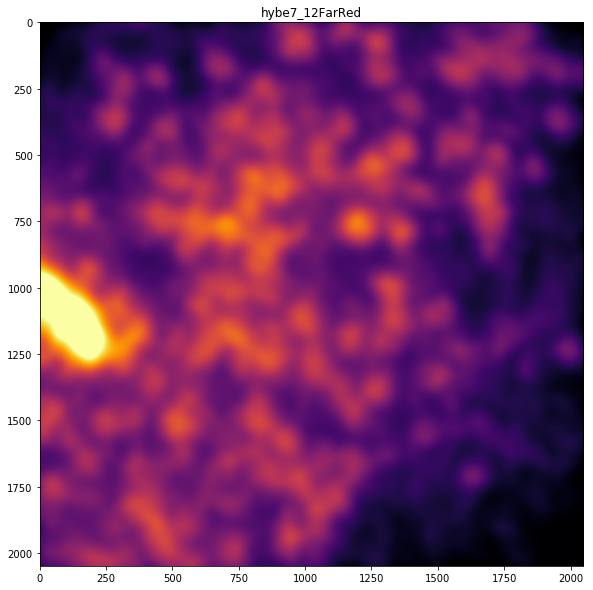

opening img_Pos1_000000032_000000000_Orange_000_032.tif

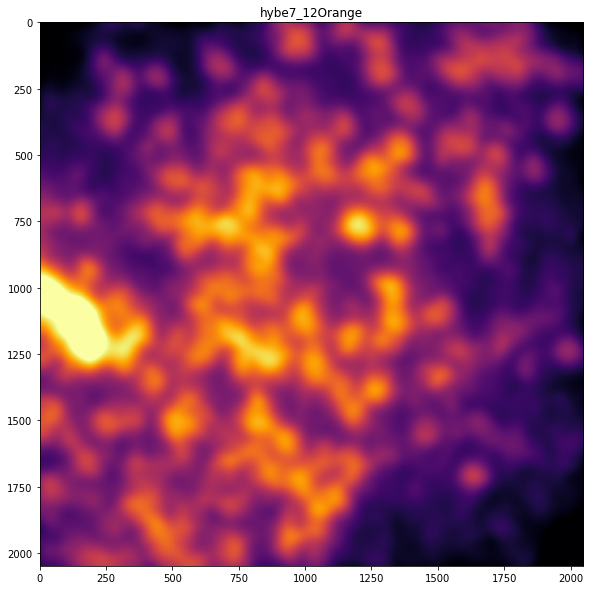

opening img_Pos1_000000032_000000000_FarRed_000_032.tif

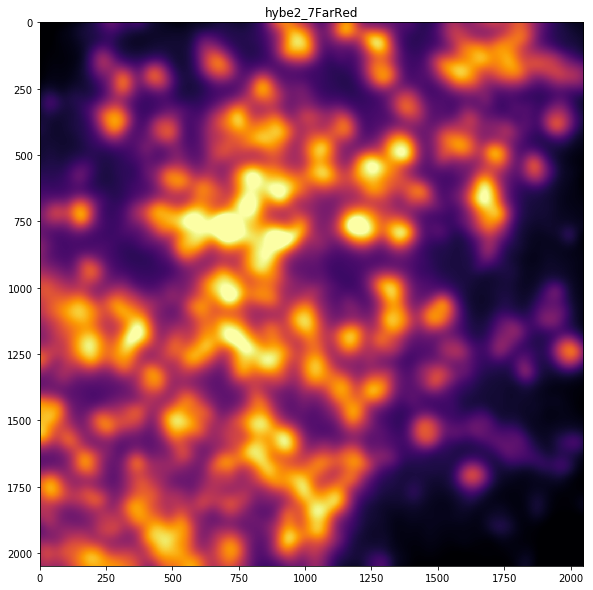

opening img_Pos1_000000032_000000000_Orange_000_032.tif

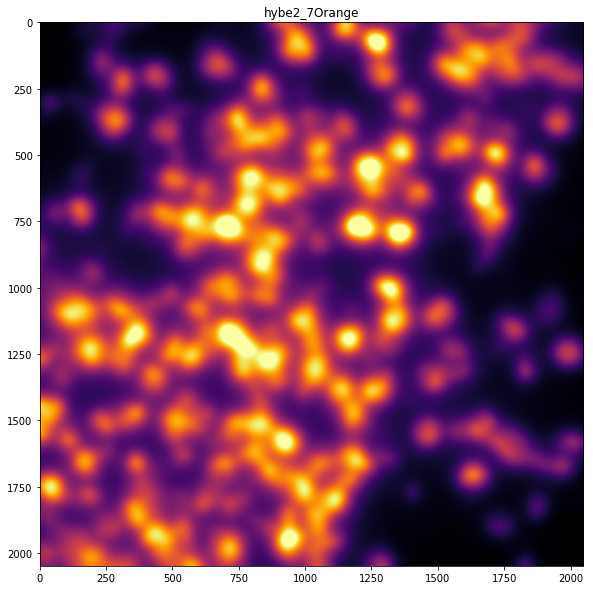

opening img_Pos1_000000032_000000000_FarRed_000_032.tif

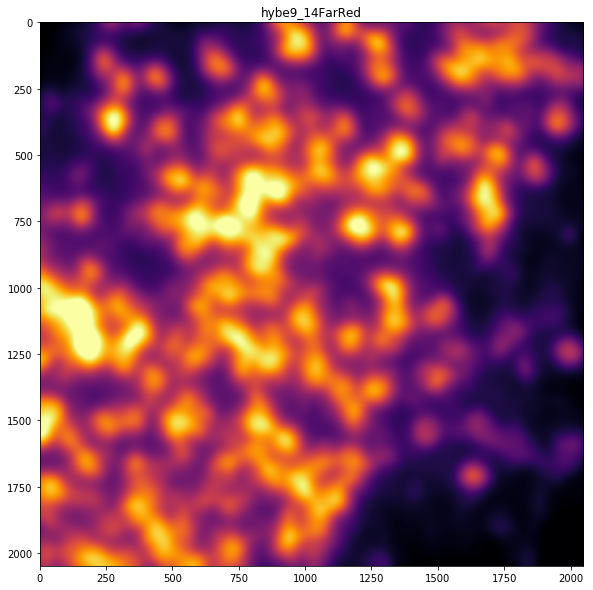

opening img_Pos1_000000032_000000000_Orange_000_032.tif

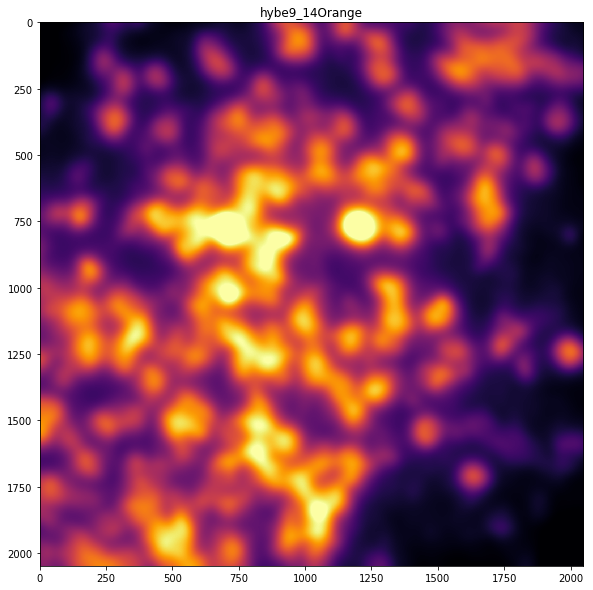

opening img_Pos1_000000032_000000000_FarRed_000_032.tif

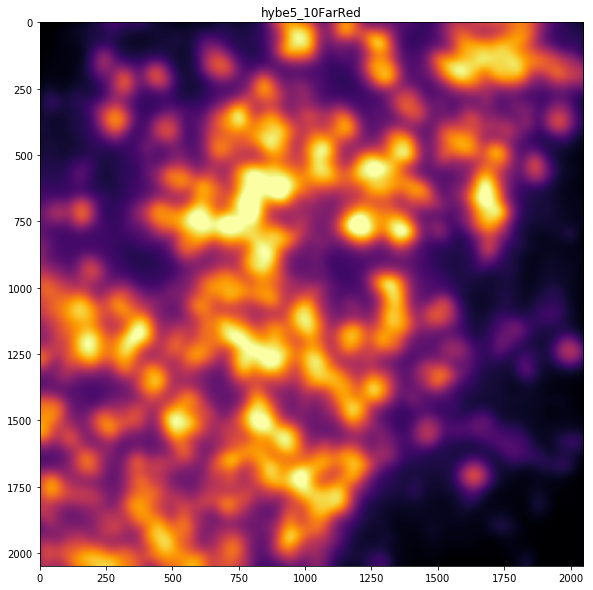

opening img_Pos1_000000032_000000000_Orange_000_032.tif

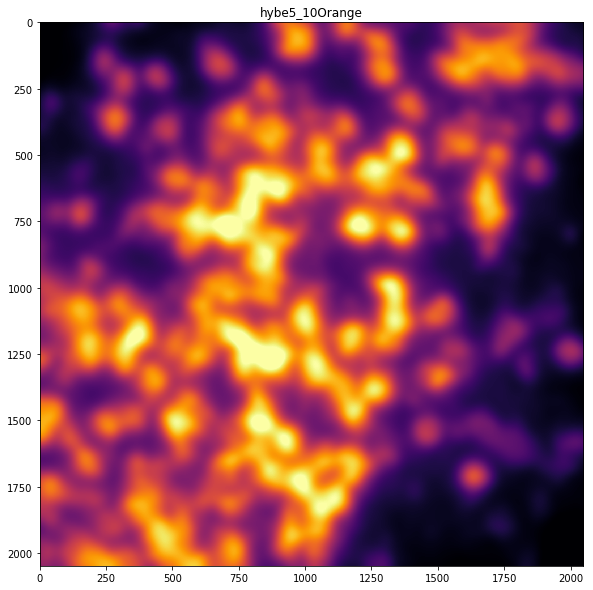

opening img_Pos1_000000032_000000000_FarRed_000_032.tif

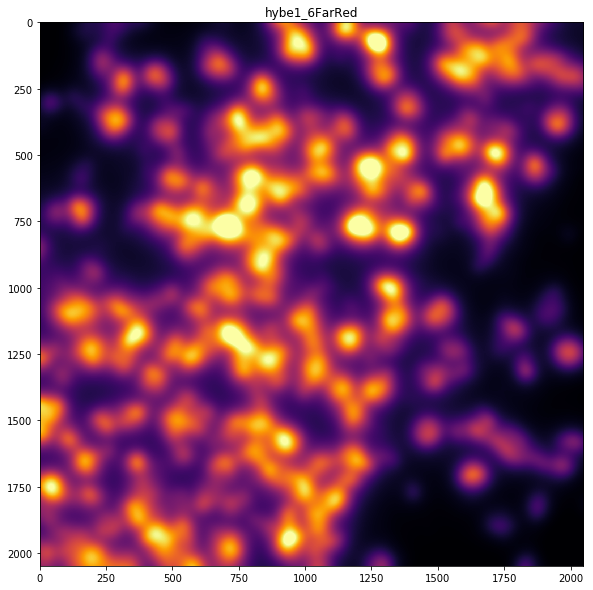

opening img_Pos1_000000032_000000000_Orange_000_032.tif

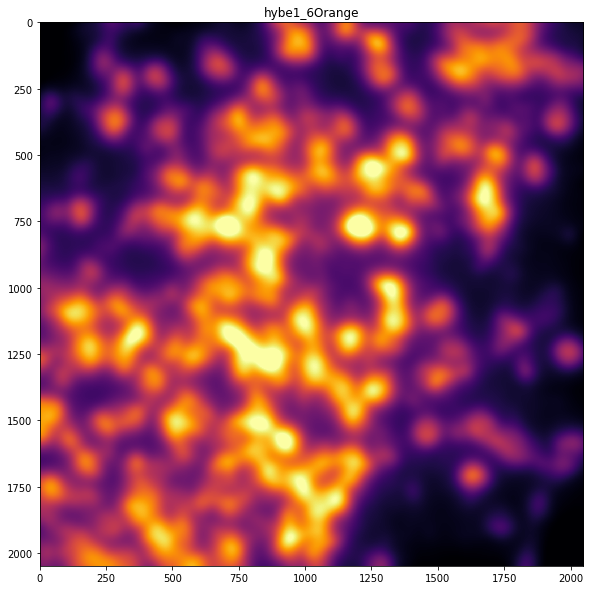

opening img_Pos1_000000032_000000000_FarRed_000_032.tif

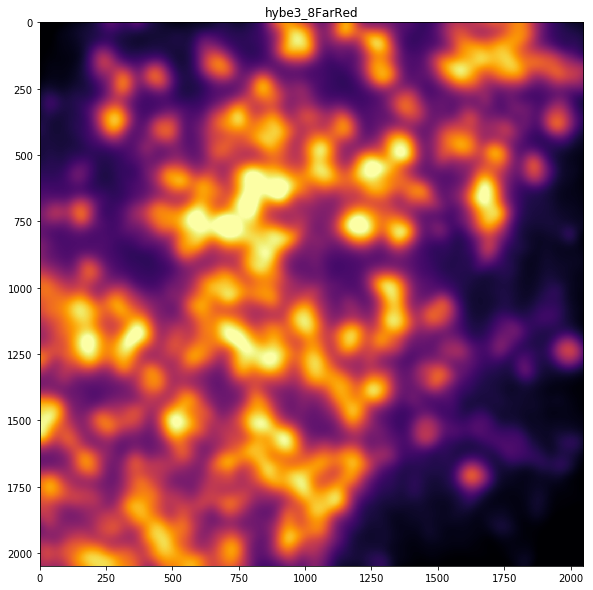

opening img_Pos1_000000032_000000000_Orange_000_032.tif

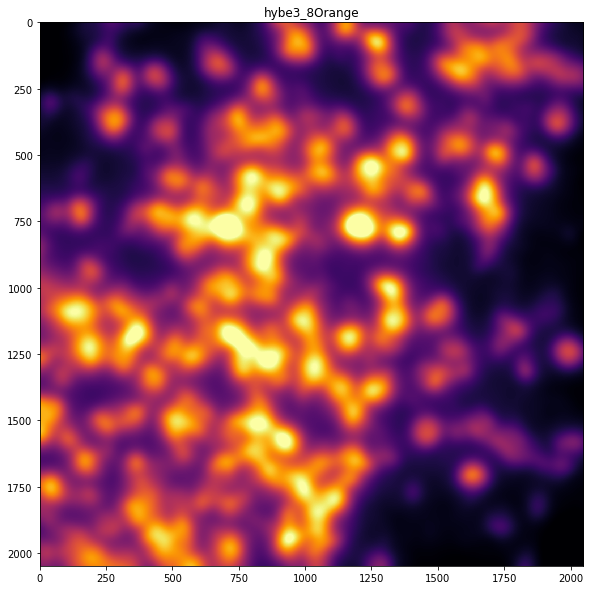

opening img_Pos1_000000032_000000000_FarRed_000_032.tif

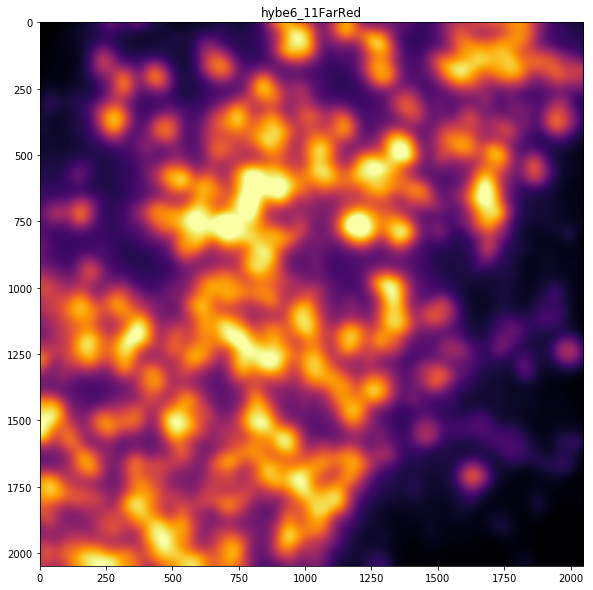

opening img_Pos1_000000032_000000000_Orange_000_032.tif

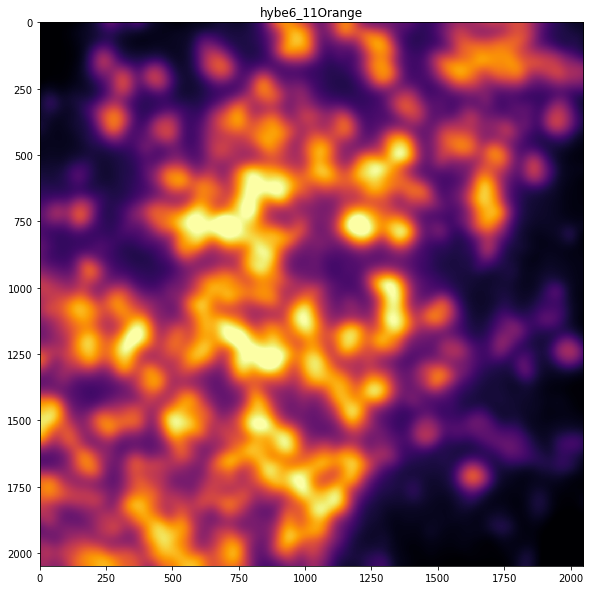

In [186]:
pos = 'Pos1'
intensity_dict = {}
r = 5
for acq in md.acqnames:
    if 'hybe' in acq:
        for color in ['FarRed','Orange']:
            intensity_dict[str(acq+'_'+color)] = []
            stk = md.stkread(Position=pos,Channel=color,acq=acq)
            img = np.sum(stk,axis=2)
            blurred = filters.gaussian(img, 20)
            Display(blurred,title=str(acq)+str(color))
            for cell in pos1.index:
                x = pos1.loc[cell].y
                y = pos1.loc[cell].x
                intensity_dict[str(acq+'_'+color)].append(blurred[x,y])

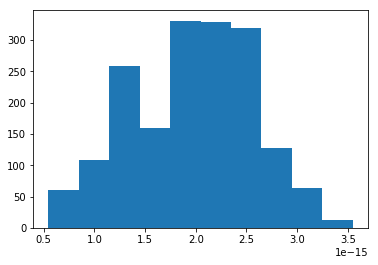

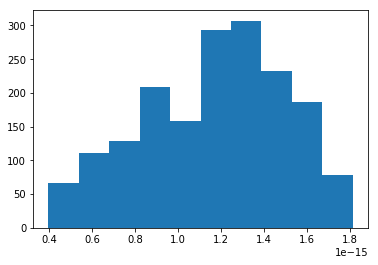

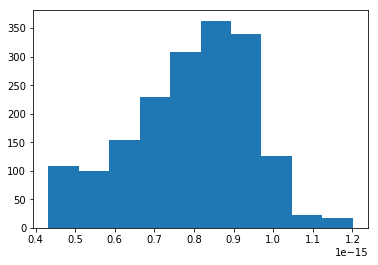

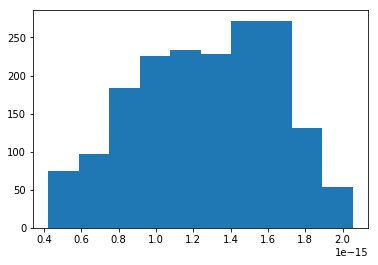

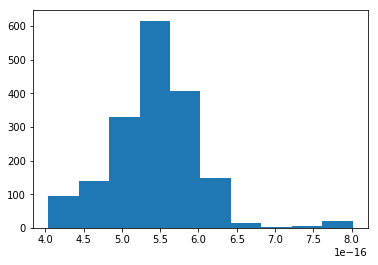

...

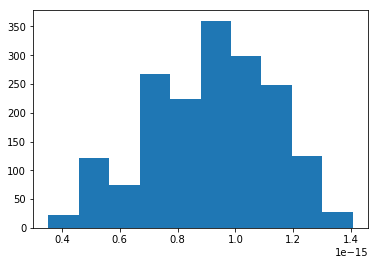

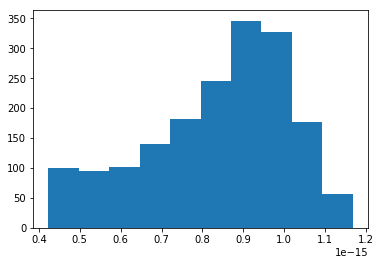

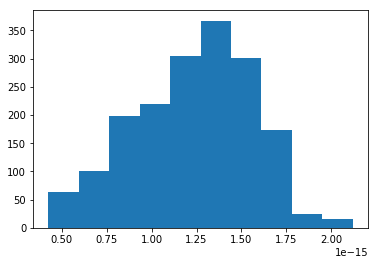

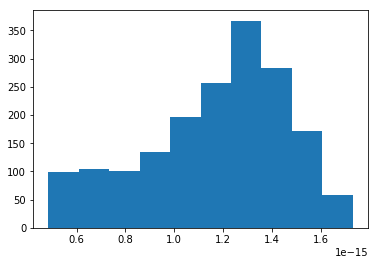

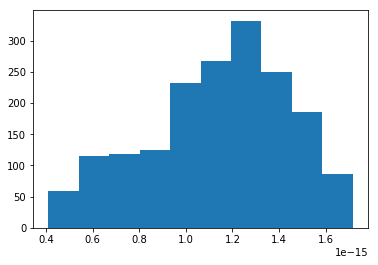

In [187]:
compressed_measurement = np.zeros([len(pos1),len(intensity_dict.keys())])
for x,key in enumerate(intensity_dict.keys()):
    for y,value in enumerate(intensity_dict[key]):
        compressed_measurement[y,x] = value
for x in range(compressed_measurement.shape[1]):
    plt.hist(compressed_measurement[:,x])
    plt.show()

In [634]:
MERFISH_clustered

,x,y,z,Sema5a,Ttyh2,Tnfaip8l3,Cacna2d1,Ncan,Spry2,Epb41l4b,...,Myo3a,Sap30bpos,Rassf3,Prox1,Grm2,Casp8,Plekha5,Selplg,stage_x,stage_y
0,6014.663727,1107.132364,13.090909,0,0,0,3,5,2,1,...,0,0,0,0,0,0,0,0,6394.132364,1114.336273
1,5106.636071,1767.304571,13.857143,6,1,0,1,12,2,4,...,0,0,0,0,0,0,0,0,5155.304571,1811.363929
2,5027.884769,3434.885846,14.000000,13,7,1,5,18,5,3,...,0,0,0,0,0,0,0,0,5346.885846,3366.115231
3,4555.973250,2721.659750,7.250000,0,0,0,0,13,1,0,...,0,0,0,0,0,1,0,0,4844.659750,2783.026750
4,3711.211867,1850.601333,16.266667,4,2,0,1,21,1,1,...,0,0,2,0,0,0,0,0,3902.601333,1870.788133
5,4720.964769,2819.000000,14.000000,0,7,0,0,10,1,2,...,0,0,0,1,0,0,0,0,4942.000000,3040.035231
6,4775.200933,1920.412200,13.600000,5,1,3,7,12,2,4,...,0,0,0,0,0,0,1,0,5097.412200,1931.799067
7,5644.806071,944.660786,14.714286,1,8,0,2,17,1,6,...,0,0,0,0,1,0,0,5,5809.660786,1062.193929
8,5832.316571,1742.118429,13.142857,0,0,1,2,0,1,2,...,0,0,0,0,0,0,0,0,6185.118429,1718.683429
9,5139.920000,1852.370312,12.500000,10,0,0,15,25,1,9,...,0,0,0,0,1,0,0,0,5240.370312,1778.080000


In [643]:
pos_stage_x = []
pos_stage_y = []
posnames = []
for pos in md.posnames:
    if 'Pos' in pos:
        posnames.append(pos)
        x,y = md.image_table[md.image_table.Position==pos].XY.iloc[0]
        pos_stage_x.append(x)
        pos_stage_y.append(y)
pos_XY_df = pd.DataFrame(index=posnames)
pos_XY_df['x'] = pos_stage_x
pos_XY_df['y'] = pos_stage_y
pos_XY_df

,x,y
Pos1,2411.0,-3087.0
Pos2,2411.0,-2876.0
Pos9,2622.0,-2876.0
Pos3,2411.0,-2665.0
Pos10,2622.0,-2665.0
Pos19,2833.0,-2665.0
Pos34,3044.0,-2665.0
Pos51,3255.0,1343.0
Pos35,3044.0,1343.0
Pos20,2833.0,1343.0


In [665]:
pos_XY_df['x_center'] = pos_XY_df['x']+(2048*0.109)/2
pos_XY_df['y_center'] = pos_XY_df['y']+(2048*0.109)/2
pos_XY_df

,x,y,x_center,y_center
Pos1,2411.0,-3087.0,2522.616,-2975.384
Pos2,2411.0,-2876.0,2522.616,-2764.384
Pos9,2622.0,-2876.0,2733.616,-2764.384
Pos3,2411.0,-2665.0,2522.616,-2553.384
Pos10,2622.0,-2665.0,2733.616,-2553.384
Pos19,2833.0,-2665.0,2944.616,-2553.384
Pos34,3044.0,-2665.0,3155.616,-2553.384
Pos51,3255.0,1343.0,3366.616,1454.616
Pos35,3044.0,1343.0,3155.616,1454.616
Pos20,2833.0,1343.0,2944.616,1454.616


In [666]:
cell_pos = []
cell_pixel_x = []
cell_pixel_y = []
pixel_size=0.109
cameradirection = [1,1]
for cell in MERFISH_clustered.index:
    x = MERFISH_clustered['stage_x'].loc[cell]
    y = MERFISH_clustered['stage_y'].loc[cell]
    cp = pd.DataFrame(np.sqrt(((pos_XY_df['x_center']-x)**2)+((pos_XY_df['y_center']-y)**2)).sort_values()).index[0]
    cell_pos.append(cp)
    px = pos_XY_df['x'].loc[cp]
    py = pos_XY_df['y'].loc[cp]
    cx = (x-px)/(pixel_size*cameradirection[0])
    cy = (y-py)/(pixel_size*cameradirection[1])
    cell_pixel_x.append(cx)
    cell_pixel_y.append(cy)
MERFISH_clustered['pos'] = cell_pos
MERFISH_clustered['pixel_x'] = cell_pixel_x
MERFISH_clustered['pixel_y'] = cell_pixel_y
MERFISH_clustered

,x,y,z,Sema5a,Ttyh2,Tnfaip8l3,Cacna2d1,Ncan,Spry2,Epb41l4b,...,Prox1,Grm2,Casp8,Plekha5,Selplg,stage_x,stage_y,pos,pixel_x,pixel_y
0,6014.663727,1107.132364,13.090909,0,0,0,3,5,2,1,...,0,0,0,0,0,6394.132364,1114.336273,Pos290,1707.636364,1773.727273
1,5106.636071,1767.304571,13.857143,6,1,0,1,12,2,4,...,0,0,0,0,0,5155.304571,1811.363929,Pos187,1956.922674,425.357143
2,5027.884769,3434.885846,14.000000,13,7,1,5,18,5,3,...,0,0,0,0,0,5346.885846,3366.115231,Pos214,1778.769231,1147.846154
3,4555.973250,2721.659750,7.250000,0,0,0,0,13,1,0,...,0,0,1,0,0,4844.659750,2783.026750,Pos173,1042.750000,1605.750000
4,3711.211867,1850.601333,16.266667,4,2,0,1,21,1,1,...,0,0,0,0,0,3902.601333,1870.788133,Pos103,143.131498,970.533333
5,4720.964769,2819.000000,14.000000,0,7,0,0,10,1,2,...,1,0,0,0,0,4942.000000,3040.035231,Pos175,1935.779817,92.066337
6,4775.200933,1920.412200,13.600000,5,1,3,7,12,2,4,...,0,0,0,1,0,5097.412200,1931.799067,Pos187,1425.800000,1530.266667
7,5644.806071,944.660786,14.714286,1,8,0,2,17,1,6,...,0,1,0,0,5,5809.660786,1062.193929,Pos265,217.071429,1295.357143
8,5832.316571,1742.118429,13.142857,0,0,1,2,0,1,2,...,0,0,0,0,0,6185.118429,1718.683429,Pos283,1725.857143,1510.857143
9,5139.920000,1852.370312,12.500000,10,0,0,15,25,1,9,...,0,1,0,0,0,5240.370312,1778.080000,Pos207,801.562500,120.000000


In [771]:
MERFISH_clustered

,x,y,z,Sema5a,Ttyh2,Tnfaip8l3,Cacna2d1,Ncan,Spry2,Epb41l4b,...,Prox1,Grm2,Casp8,Plekha5,Selplg,stage_x,stage_y,pos,pixel_x,pixel_y
0,6014.663727,1107.132364,13.090909,0,0,0,3,5,2,1,...,0,0,0,0,0,6394.132364,1114.336273,Pos290,1707.636364,1773.727273
1,5106.636071,1767.304571,13.857143,6,1,0,1,12,2,4,...,0,0,0,0,0,5155.304571,1811.363929,Pos187,1956.922674,425.357143
2,5027.884769,3434.885846,14.000000,13,7,1,5,18,5,3,...,0,0,0,0,0,5346.885846,3366.115231,Pos214,1778.769231,1147.846154
3,4555.973250,2721.659750,7.250000,0,0,0,0,13,1,0,...,0,0,1,0,0,4844.659750,2783.026750,Pos173,1042.750000,1605.750000
4,3711.211867,1850.601333,16.266667,4,2,0,1,21,1,1,...,0,0,0,0,0,3902.601333,1870.788133,Pos103,143.131498,970.533333
5,4720.964769,2819.000000,14.000000,0,7,0,0,10,1,2,...,1,0,0,0,0,4942.000000,3040.035231,Pos175,1935.779817,92.066337
6,4775.200933,1920.412200,13.600000,5,1,3,7,12,2,4,...,0,0,0,1,0,5097.412200,1931.799067,Pos187,1425.800000,1530.266667
7,5644.806071,944.660786,14.714286,1,8,0,2,17,1,6,...,0,1,0,0,5,5809.660786,1062.193929,Pos265,217.071429,1295.357143
8,5832.316571,1742.118429,13.142857,0,0,1,2,0,1,2,...,0,0,0,0,0,6185.118429,1718.683429,Pos283,1725.857143,1510.857143
9,5139.920000,1852.370312,12.500000,10,0,0,15,25,1,9,...,0,1,0,0,0,5240.370312,1778.080000,Pos207,801.562500,120.000000


In [778]:
pos = 'Pos64'
temp_df = MERFISH_clustered[MERFISH_clustered.pos==pos]
def find_intensities(temp_df,md):
    pos = temp_df.pos.iloc[0]
    stk = md.stkread(Position=pos,Channel='DeepBlue',acq= [i for i in md.acqnames if 'nucstain' in i])
    img = np.sum(stk,axis=2).astype('float64')
    blur = filters.gaussian(img,10)
    Intensity = []
    for cell in temp_df.index:
        x = int(temp_df['pixel_x'].loc[cell])
        y = int(temp_df['pixel_y'].loc[cell])
        Intensity.append(blur[x,y])
    temp_df['nuclear intensity'] = Intensity
    return temp_df

import tqdm.notebook as tqdm
from multiprocessing import Pool
import sys
from functools import partial
sys.stdout.flush()
pfunc = partial(find_intensities,md=md)
Input = [MERFISH_clustered[MERFISH_clustered.pos==pos] for pos in MERFISH_clustered.pos.unique()]
temp_dfs = []
with Pool(30) as p:
    for temp_df in tqdm.tqdm(p.imap(pfunc,Input,chunksize=1),total=len(Input)):
        temp_dfs.append(temp_df)
sys.stdout.flush()

opening img_Pos47_000000032_000000000_DeepBlue_000_032.tiff


In [786]:
MERFISH_clustered['Nuclear Intensity'] = pd.concat(temp_dfs)['nuclear intensity']
MERFISH_clustered

,x,y,z,Sema5a,Ttyh2,Tnfaip8l3,Cacna2d1,Ncan,Spry2,Epb41l4b,...,Grm2,Casp8,Plekha5,Selplg,stage_x,stage_y,pos,pixel_x,pixel_y,Nuclear Intensity
0,6014.663727,1107.132364,13.090909,0,0,0,3,5,2,1,...,0,0,0,0,6394.132364,1114.336273,Pos290,1707.636364,1773.727273,63297.906129
1,5106.636071,1767.304571,13.857143,6,1,0,1,12,2,4,...,0,0,0,0,5155.304571,1811.363929,Pos187,1956.922674,425.357143,18141.006814
2,5027.884769,3434.885846,14.000000,13,7,1,5,18,5,3,...,0,0,0,0,5346.885846,3366.115231,Pos214,1778.769231,1147.846154,32920.130042
3,4555.973250,2721.659750,7.250000,0,0,0,0,13,1,0,...,0,1,0,0,4844.659750,2783.026750,Pos173,1042.750000,1605.750000,15821.259095
4,3711.211867,1850.601333,16.266667,4,2,0,1,21,1,1,...,0,0,0,0,3902.601333,1870.788133,Pos103,143.131498,970.533333,55736.378568
5,4720.964769,2819.000000,14.000000,0,7,0,0,10,1,2,...,0,0,0,0,4942.000000,3040.035231,Pos175,1935.779817,92.066337,44697.257727
6,4775.200933,1920.412200,13.600000,5,1,3,7,12,2,4,...,0,0,1,0,5097.412200,1931.799067,Pos187,1425.800000,1530.266667,95307.478892
7,5644.806071,944.660786,14.714286,1,8,0,2,17,1,6,...,1,0,0,5,5809.660786,1062.193929,Pos265,217.071429,1295.357143,17419.514852
8,5832.316571,1742.118429,13.142857,0,0,1,2,0,1,2,...,0,0,0,0,6185.118429,1718.683429,Pos283,1725.857143,1510.857143,32219.327649
9,5139.920000,1852.370312,12.500000,10,0,0,15,25,1,9,...,1,0,0,0,5240.370312,1778.080000,Pos207,801.562500,120.000000,29925.227539


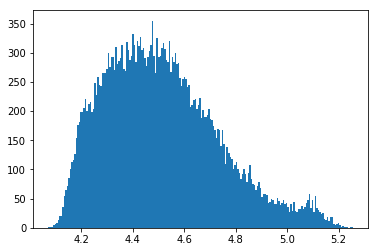

In [869]:
plt.hist(np.log10(MERFISH_clustered['Nuclear Intensity']),bins=200)
plt.show()

In [ ]:
spots = pd.read_csv('/scratch/sham_m3_slide4_zach_export.csv',index_col=0)

In [784]:
spots.head()

,gene,ave,z,CoordX,CoordY,pixel_x,pixel_y
0,Gad2,21.937500,2,2437.541500,-3086.891000,243.500000,1.000000
1,Nes,25.125000,2,2594.256250,-3086.673000,1681.250000,3.000000
2,Casp8,19.833333,2,2590.414000,-3086.618500,1646.000000,3.500000
3,Gfra1,41.450000,2,2606.197200,-3086.629400,1790.800000,3.400000
4,Fezf2,57.678571,2,2552.762286,-3086.439429,1300.571429,5.142857


In [780]:
# Assign cells to spots
from sklearn.metrics.pairwise import euclidean_distances
cell_XY = np.zeros((len(MERFISH_clustered),2))
cell_XY[:,0] = MERFISH_clustered['stage_x']
cell_XY[:,1] = MERFISH_clustered['stage_y']
spots_XY = np.zeros((len(spots),2))
spots_XY[:,0] = spots['CoordX']
spots_XY[:,1] = spots['CoordY']
dist = euclidean_distances(cell_XY, spots_XY)
rank = dist.argpartition(1,axis=0)[1,:]

MemoryError: 

In [793]:
spots_sorted = spots.sort_values('CoordX')

,gene,ave,z,CoordX,CoordY,pixel_x,pixel_y
28780,Fam178b,45.150000,14,2411.000000,-2930.476000,0.000000,1436.000000
5238699,blank10,16.125000,4,2411.027250,-2629.248000,0.250000,4199.559633
36365,Spry2,41.875000,18,2411.027250,-3007.620750,0.250000,728.250000
13905,Pcdh17,65.812500,8,2411.027250,-2911.755250,0.250000,1607.750000
2653726,Pcdh17,66.750000,16,2411.036333,-2836.596500,0.333333,2297.279817
2660604,Gpd1,59.200000,20,2411.043600,-2738.027800,0.400000,3201.579817
2636733,Bptf,51.050000,4,2411.043600,-2689.588200,0.400000,3645.979817
2654302,Plxna4,60.250000,16,2411.043600,-2800.920800,0.400000,2624.579817
2643217,Htr2c,44.800000,10,2411.043600,-2858.320200,0.400000,2097.979817
41585,Serpine2,59.800000,20,2411.043600,-2914.365800,0.400000,1583.800000


In [859]:
len(spots_sorted)/chunksize

7310.57

In [861]:
# Convert to 3d
def assign_spots(temp_spots_df,MERFISH_clustered,rad = 100):
    spots_XY = np.zeros((len(temp_spots_df),2))
    spots_XY[:,0] = temp_spots_df['CoordX']
    spots_XY[:,1] = temp_spots_df['CoordY']

    x_min = np.min(spots_XY[:,0])-rad
    x_max = np.max(spots_XY[:,0])+rad
    y_min = np.min(spots_XY[:,1])-rad
    y_max = np.max(spots_XY[:,1])+rad
    temp_cell_df = MERFISH_clustered[(MERFISH_clustered['stage_x']>x_min)&
                          (MERFISH_clustered['stage_x']<x_max)&
                          (MERFISH_clustered['stage_y']>y_min)&
                          (MERFISH_clustered['stage_y']<y_max)]
    cell_XY = np.zeros((len(temp_cell_df),2))
    cell_XY[:,0] = temp_cell_df['stage_x']
    cell_XY[:,1] = temp_cell_df['stage_y']

    cells = []
    distance_list = []
    for i in range(spots_XY.shape[0]):
        distances = np.sqrt(np.sum((cell_XY-spots_XY[i,:])**2,axis=1))
        min_distance = np.min(distances)
        cell = np.where(distances==np.min(distances))[0][0]
        cells.append(temp_cell_df.index[cell])
        distance_list.append(min_distance)
    temp_spots_df['cell'] = cells
    temp_spots_df['distance'] = distance_list
    return temp_spots_df
import tqdm.notebook as tqdm
from multiprocessing import Pool
import sys
from functools import partial
sys.stdout.flush()
pfunc = partial(assign_spots,MERFISH_clustered=MERFISH_clustered)
spots_sorted = spots.sort_values('CoordX')
chunksize = 10000
Input = []
for i in range(int(len(spots_sorted)/chunksize)+1):
    temp_spots_df = spots_sorted.iloc[i*chunksize:(i*chunksize)+chunksize]
    Input.append(temp_spots_df)
temp_dfs = []
with Pool(30) as p:
    for temp_df in tqdm.tqdm(p.imap(pfunc,Input,chunksize=1),total=len(Input)):
        temp_dfs.append(temp_df)
sys.stdout.flush()

In [862]:
temp_spots_df = pd.concat(temp_dfs)
temp_spots_df

,gene,ave,z,CoordX,CoordY,pixel_x,pixel_y,cell,distance
28780,Fam178b,45.150000,14,2411.000000,-2930.476000,0.000000,1436.000000,16055,3.544897
5238699,blank10,16.125000,4,2411.027250,-2629.248000,0.250000,4199.559633,15064,9.834034
36365,Spry2,41.875000,18,2411.027250,-3007.620750,0.250000,728.250000,29406,6.503223
13905,Pcdh17,65.812500,8,2411.027250,-2911.755250,0.250000,1607.750000,17812,7.410135
2653726,Pcdh17,66.750000,16,2411.036333,-2836.596500,0.333333,2297.279817,15091,6.262150
2660604,Gpd1,59.200000,20,2411.043600,-2738.027800,0.400000,3201.579817,15038,10.143529
2636733,Bptf,51.050000,4,2411.043600,-2689.588200,0.400000,3645.979817,25191,2.161365
2654302,Plxna4,60.250000,16,2411.043600,-2800.920800,0.400000,2624.579817,16855,6.103167
2643217,Htr2c,44.800000,10,2411.043600,-2858.320200,0.400000,2097.979817,18167,2.722999
41585,Serpine2,59.800000,20,2411.043600,-2914.365800,0.400000,1583.800000,17812,4.802425


In [853]:
import matplotlib.colors as mcolors
colors = mcolors.CSS4_COLORS
color = colors[random.sample(list(colors.keys()),1)[0]]
color

'#0000CD'

In [ ]:
import matplotlib.colors as mcolors
colors = mcolors.CSS4_COLORS
temp = temp_spots_df[(temp_spots_df['CoordX']>3000)&
                     (temp_spots_df['CoordX']<3500)&
                     (temp_spots_df['CoordY']>2000)&
                     (temp_spots_df['CoordY']<2500)]
# cells = random.sample(list(temp.cell.unique()),1000)
cells = temp_spots_df.cell.unique()
for cell in cells:
    color = colors[random.sample(list(colors.keys()),1)[0]]
    temp_df = temp_spots_df[(temp_spots_df.cell==cell)&(temp_spots_df.distance<20)]
    plt.scatter(temp_df['CoordX'],temp_df['CoordY'],c=color,s=0.01,alpha=0.5)
    plt.scatter(MERFISH_clustered['stage_x'].loc[cell],MERFISH_clustered['stage_y'].loc[cell],c=color,s=0.1,alpha=0.5)
plt.show()


KeyboardInterrupt: 

In [ ]:
# generate scMatrix from MERFISH

In [ ]:
MERFISH_clustered

In [ ]:
Intensities = np.log10(MERFISH_clustered['Nuclear Intensity'])
counts = np.log10(np.sum(MERFISH_clustered))
plt.show()

In [669]:
MERFISH_clustered.drop(columns=['x','y']).to_csv('/bigstore/GeneralStorage/Zach/CSI/MERFISH_clustered.csv.gz',compression='gzip')

opening img_Pos1_000000032_000000000_DeepBlue_000_032.tif

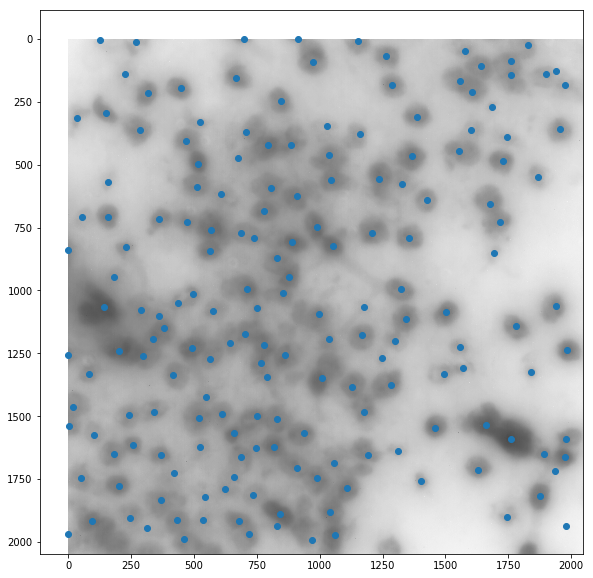

In [668]:
stk = md.stkread(Position='Pos1',Channel='DeepBlue',acq=[i for i in md.acqnames if 'nucstain' in i]).astype('float64')
img = np.average(stk,axis=2)
temp_df = MERFISH_clustered[MERFISH_clustered.pos=='Pos1']
plt.figure(figsize=[10,10])
plt.imshow(np.log10(img),cmap='Greys')
plt.scatter(temp_df['pixel_x'],temp_df['pixel_y'])
plt.show()

opening img_Pos237_000000032_000000000_DeepBlue_000_032.tif

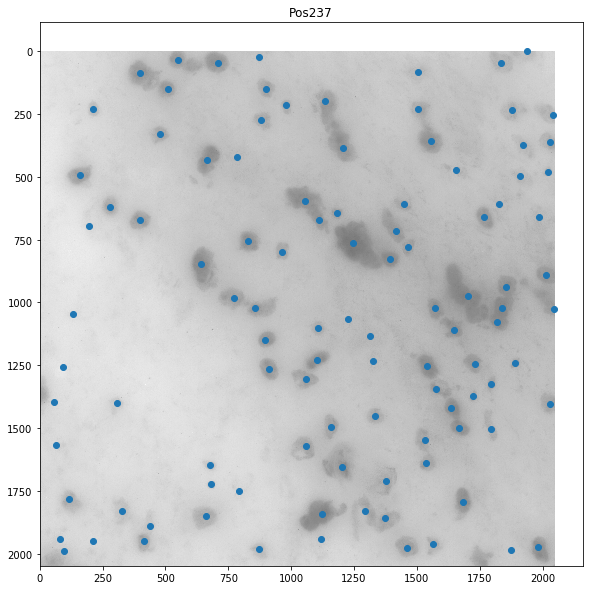

opening img_Pos149_000000032_000000000_DeepBlue_000_032.tif

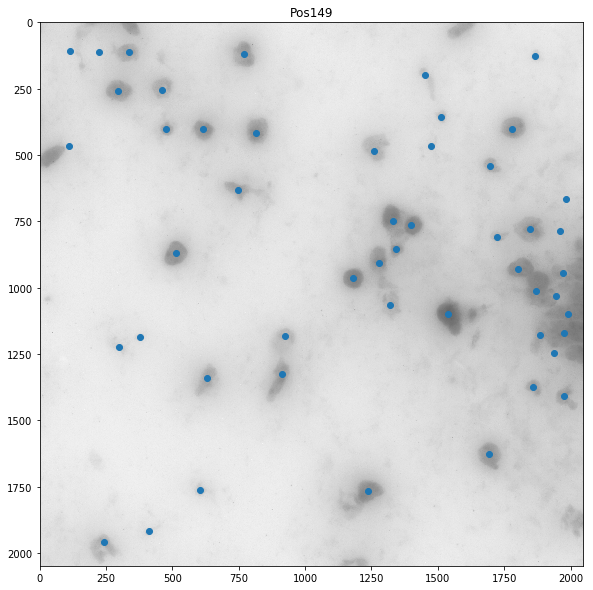

opening img_Pos288_000000032_000000000_DeepBlue_000_032.tif

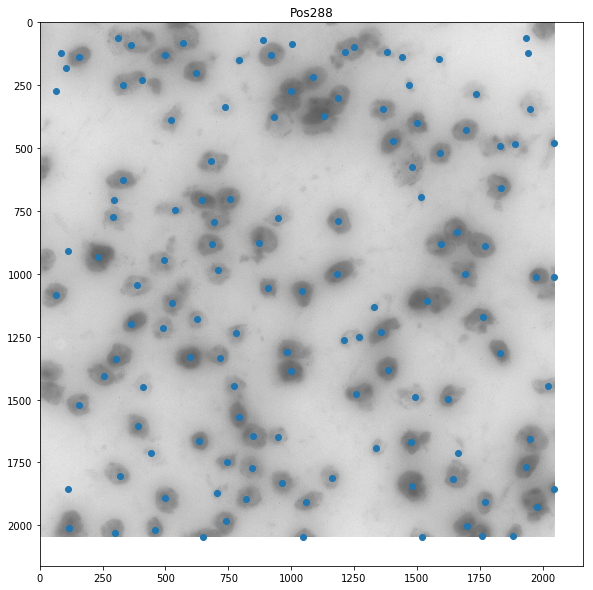

opening img_Pos22_000000032_000000000_DeepBlue_000_032.tif

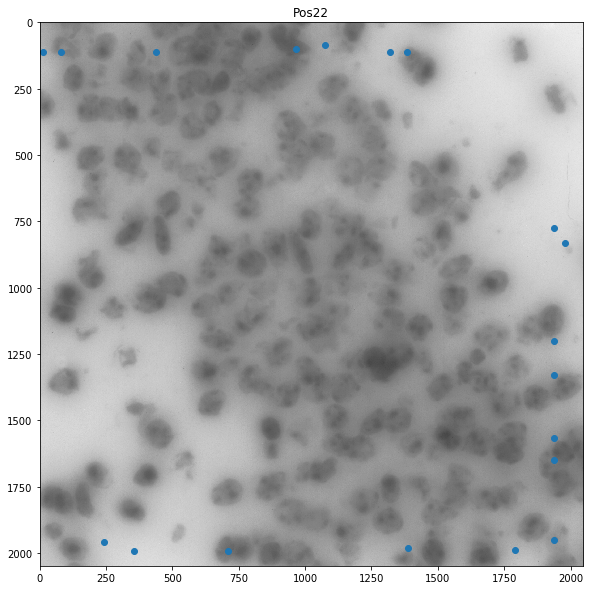

opening img_Pos198_000000032_000000000_DeepBlue_000_032.tif

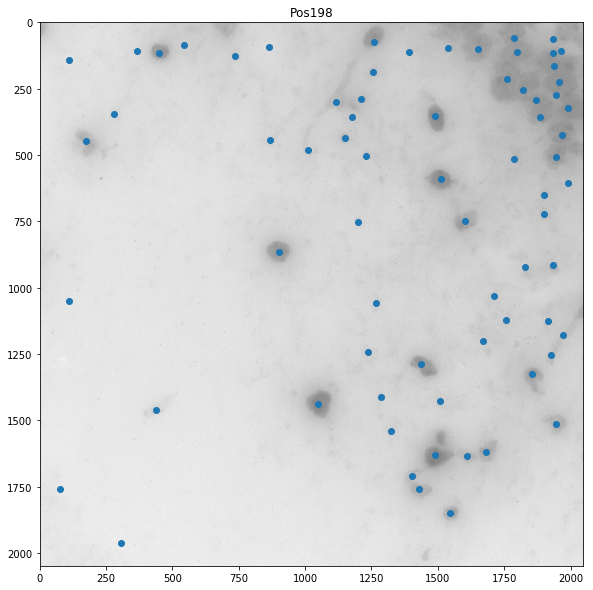

opening img_Pos133_000000032_000000000_DeepBlue_000_032.tif

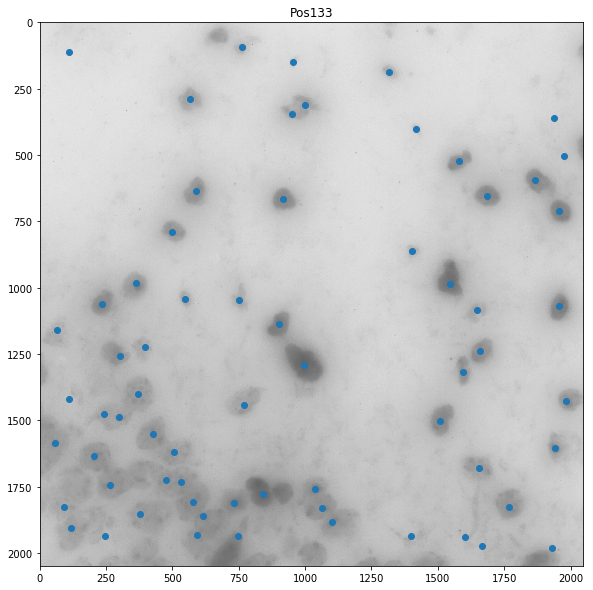

opening img_Pos281_000000032_000000000_DeepBlue_000_032.tif

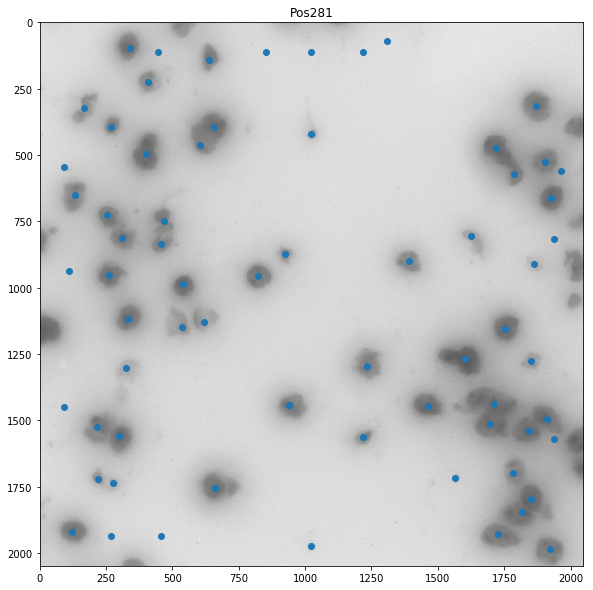

opening img_Pos259_000000032_000000000_DeepBlue_000_032.tif

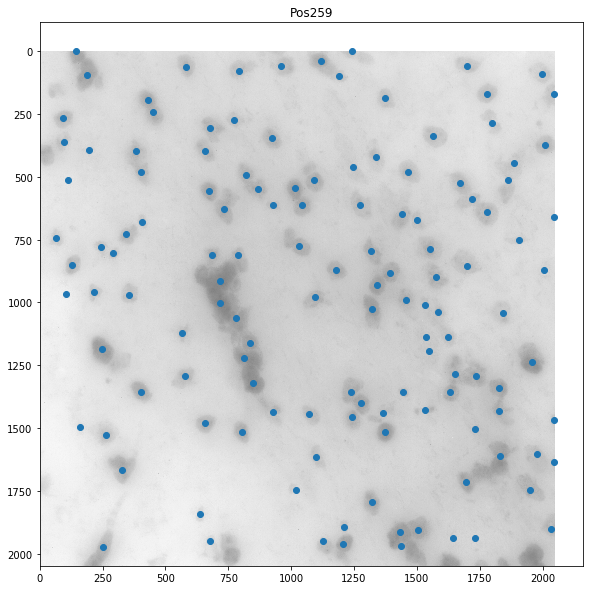

opening img_Pos100_000000032_000000000_DeepBlue_000_032.tif

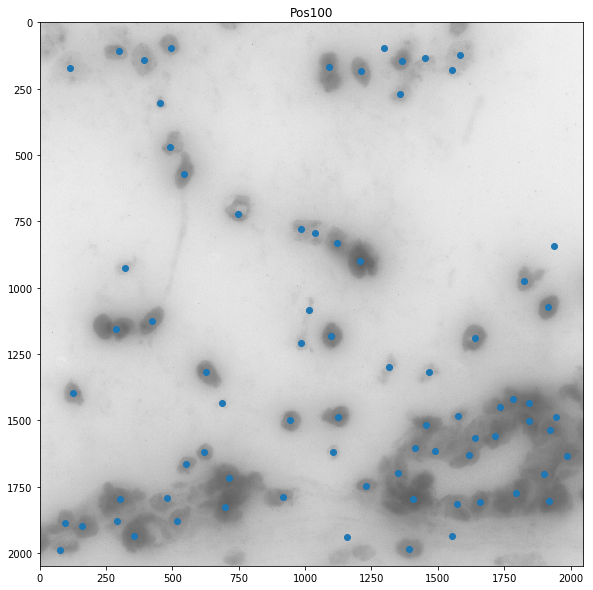

opening img_Pos67_000000032_000000000_DeepBlue_000_032.tif

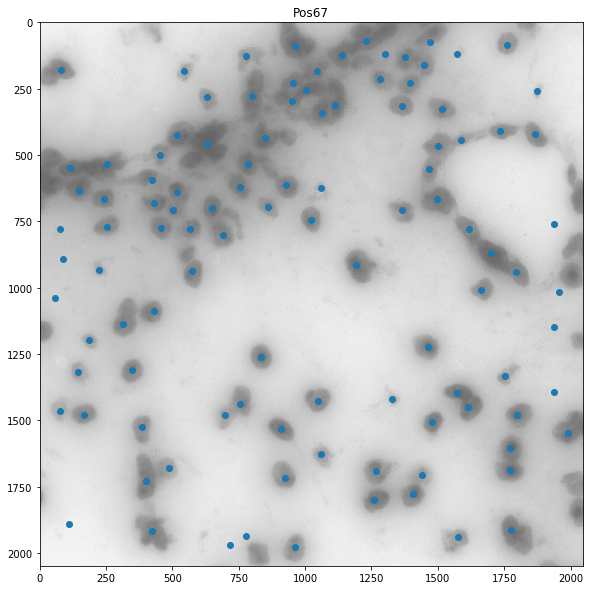

In [770]:
for pos in random.sample(list(MERFISH_clustered.pos.unique()),10):
    stk = md.stkread(Position=pos,Channel='DeepBlue',acq=[i for i in md.acqnames if 'nucstain' in i]).astype('float64')
    img = np.max(stk,axis=2)
    temp_df = MERFISH_clustered[MERFISH_clustered.pos==pos]
    plt.figure(figsize=[10,10])
    plt.imshow(np.log10(img),cmap='Greys')
    plt.scatter(temp_df['pixel_x'],temp_df['pixel_y'])
    plt.title(pos)
    plt.show()

In [125]:
Sham3_cell = pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/Hippocampus_sham_m3_segmented_data/Merged.Cells.pixel.Coords.csv.gz')

In [188]:
pickle.dump(compressed_measurement,open('/bigstore/GeneralStorage/Zach/CSI/compressed_measurement.pkl','wb'))

In [682]:
pos='Pos1'
stk = md.stkread(Position=pos,Channel=color,acq=acq).astype('float64')
img = np.sum(stk,axis=2)
blurred = filters.gaussian(img, 20)
background = filters.gaussian(img, 200)

opening img_Pos1_000000032_000000000_Orange_000_032.tif

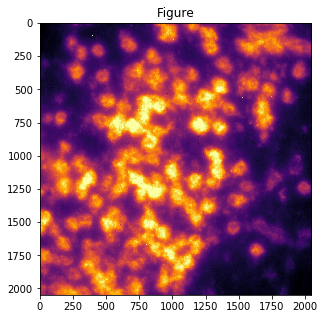

In [684]:
Display(img,figsize=[5,5])

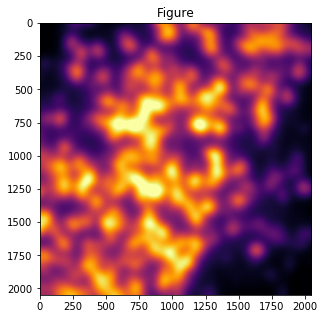

In [697]:
Display(filters.gaussian(img, 30),figsize=[5,5])

In [690]:
len(coeffs)

7

In [687]:
from segmentation_3D import *


spearman 0.5562
pearson 0.4243


/home/zach/miniconda3/envs/pyspots/lib/python3.6/site-packages/ipykernel_launcher.py:50: RuntimeWarning: divide by zero encountered in log10


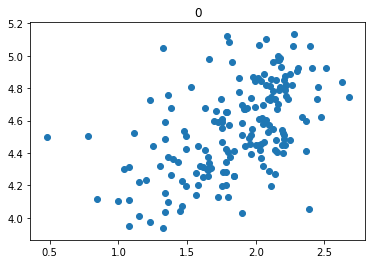


spearman 0.5226
pearson 0.4622


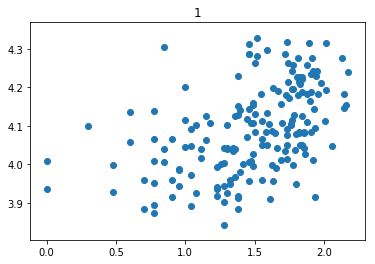


spearman 0.5853
pearson 0.4992


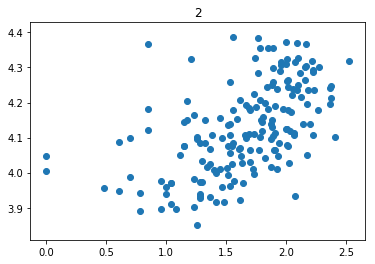


spearman 0.2316
pearson 0.2757


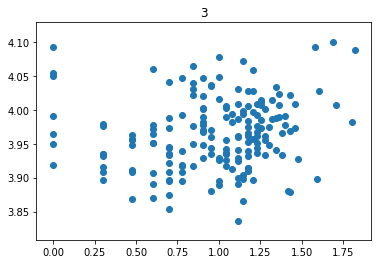


spearman 0.4593
pearson 0.4009


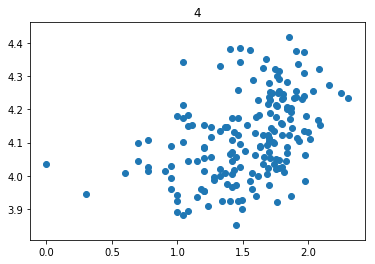


spearman 0.5513
pearson 0.4273


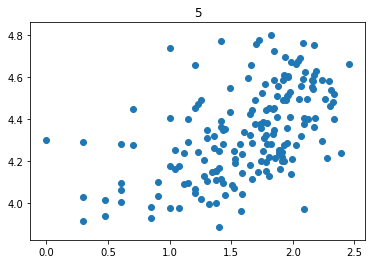


spearman 0.487
pearson 0.4469


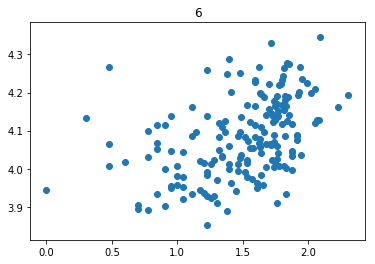


spearman 0.5594
pearson 0.4617


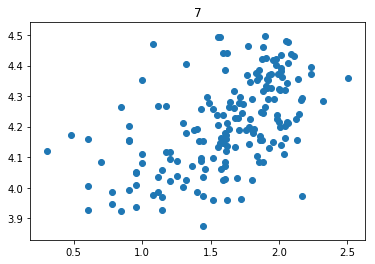


spearman 0.3792
pearson 0.3083


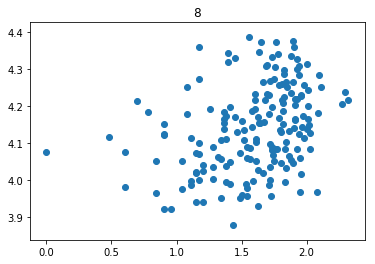


spearman 0.6039
pearson 0.5398


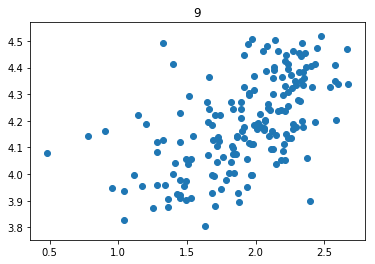


spearman 0.5237
pearson 0.472


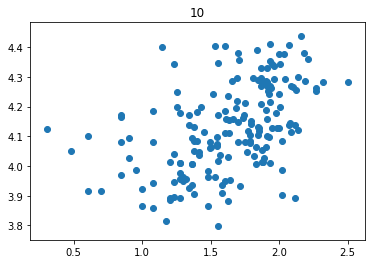


spearman 0.3969
pearson 0.3625


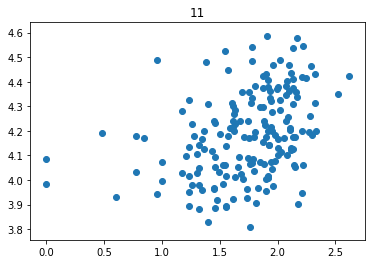


spearman 0.5272
pearson 0.4205


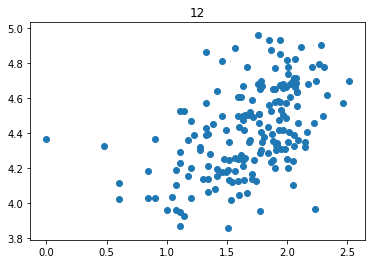


spearman 0.3614
pearson 0.3159


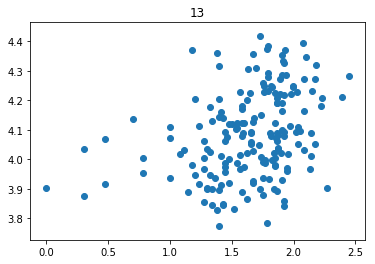


spearman 0.3948
pearson 0.3963


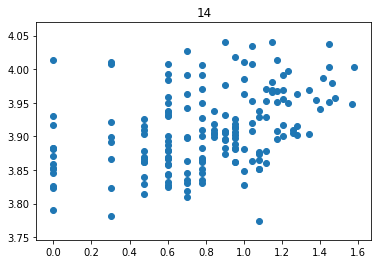


spearman 0.5656
pearson 0.4882


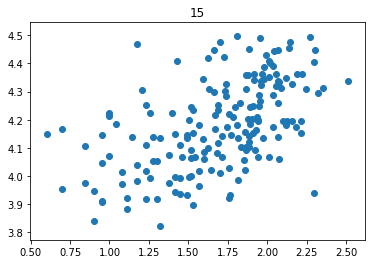


spearman 0.4386
pearson 0.4468


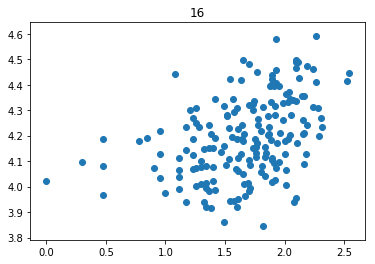


spearman 0.5556
pearson 0.5201


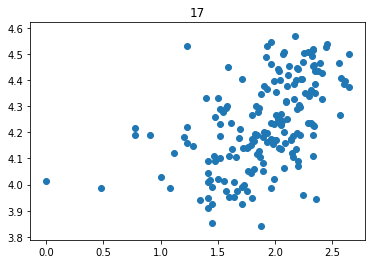

In [740]:
from scipy.stats import pearsonr
def convert2compressed(temp_df,md,blur=10):
    bitmap = [('RS0095_cy5', 'hybe1', 'FarRed'), ('RS0109_cy5', 'hybe3', 'FarRed'),
              ('RS0175_cy5', 'hybe5', 'FarRed'), ('RS0237_cy5', 'hybe7', 'FarRed'),
              ('RS0307_cy5', 'hybe2', 'FarRed'), ('RS0332_cy5', 'hybe4', 'FarRed'),
              ('RSN9927.0_cy5', 'hybe8', 'FarRed'), ('RSN2336.0_cy5', 'hybe6', 'FarRed'), 
              ('RSN1807.0_cy5', 'hybe9', 'FarRed'),
              ('RS0384_atto565', 'hybe4', 'Orange'), ('RS0406_atto565', 'hybe5', 'Orange'),
              ('RS0451_atto565', 'hybe3', 'Orange'), ('RS0468_atto565', 'hybe2', 'Orange'),
              ('RS0548_atto565', 'hybe1', 'Orange'), ('RS64.0_atto565', 'hybe7', 'Orange'),
              ('RSN4287.0_atto565', 'hybe6', 'Orange'), 
              ('RSN1252.0_atto565', 'hybe9', 'Orange'), ('RSN9535.0_atto565', 'hybe8', 'Orange')]
    pos = temp_df.pos.iloc[0]
    compressed_measurement = np.zeros((len(temp_df),18))
    for bit,bit_data in enumerate(bitmap):
        rp,hybe,color = bit_data
        acq = [i for i in md.acqnames if hybe in i]
        stk = md.stkread(Position=pos,Channel=color,acq=acq).astype('float64')
        img = np.sum(stk,axis=2)
        blurred = filters.gaussian(img, int(blur))
        for i,cell in enumerate(temp_df.index):
            x = temp_df['pixel_x'].loc[cell]
            y = temp_df['pixel_y'].loc[cell]
            compressed_measurement[i,bit] = blurred[int(x),int(y)]
    compressed_df = pd.DataFrame(compressed_measurement,index=temp_df.index)
    return compressed_df
temp_df = MERFISH_clustered[MERFISH_clustered.pos=='Pos1']
# for blur in np.linspace(0,200,20):
compressed_df = convert2compressed(temp_df,md,blur=10)
codebook_pth = '/bigstore/GeneralStorage/Rob/merfish/MERFISH_analysis-master/mouse/Doug/Hippocampus/HippocampusCodebookFinalPass2.txt'
codewords = pd.read_csv(codebook_pth,skiprows=3)
codewords.columns = ['name', 'id', 'barcode']
binary = np.zeros((len(codewords),18))
for y,barcode in enumerate(codewords.barcode):
    for x,b in enumerate(str(barcode).zfill(18)):
        binary[y,x]=b
binary_df = pd.DataFrame(binary,index=list(codewords['name']))
for i in compressed_df.columns:
    intensities = compressed_df[i]
    temp_gene_col = list(binary_df[binary_df[i]==1].index)
    counts = np.sum(temp_df[temp_gene_col],axis=1)
    print('')
    print('spearman',round(spearmanr(intensities,counts)[0],4))
    print('pearson',round(pearsonr(intensities,counts)[0],4))
    plt.scatter(np.log10(counts),np.log10(intensities))
    plt.title(i)
    plt.show()

In [202]:
from functools import partial
from multiprocessing import Pool
import tqdm.notebook as tqdm

In [741]:
Input = [MERFISH_clustered[MERFISH_clustered.pos==pos] for pos in MERFISH_clustered.pos.unique()]
pfunc = partial(convert2compressed,md=md)
sys.stdout.flush()
compressed = []
with Pool(30) as p:
    for compressed_df in tqdm.tqdm(p.imap(pfunc,Input,chunksize=1),total=len(Input)):
        compressed.append(compressed_df)
sys.stdout.flush()
full_compressed_df = pd.concat(compressed)

opening img_Pos180_000000022_000000000_Orange_000_022.tif

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



opening img_Pos47_000000001_000000000_Orange_000_001.tiff

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [742]:
pickle.dump(full_compressed_df,open('/bigstore/GeneralStorage/Zach/CSI/full_compressed_df.pkl','wb'))

In [745]:
full_compressed_df.to_csv('/bigstore/GeneralStorage/Zach/CSI/full_compressed_df.csv.gz',compression='gzip')

In [746]:
full_compressed_df.to_csv('/bigstore/GeneralStorage/Zach/CSI/full_compressed_df.csv.gz',compression='gzip')


spearman 0.1315
pearson 0.0803


/home/zach/miniconda3/envs/pyspots/lib/python3.6/site-packages/ipykernel_launcher.py:16: RuntimeWarning: divide by zero encountered in log10
  app.launch_new_instance()


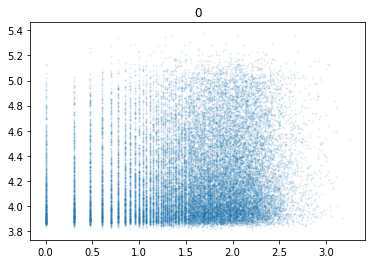


spearman 0.0893
pearson 0.0548


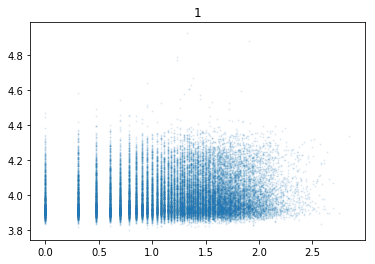


spearman 0.0904
pearson 0.0533


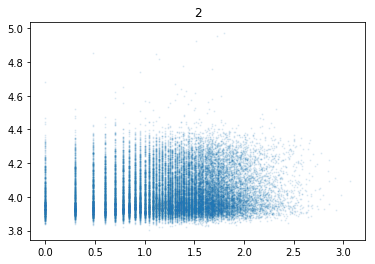


spearman 0.1219
pearson 0.0626


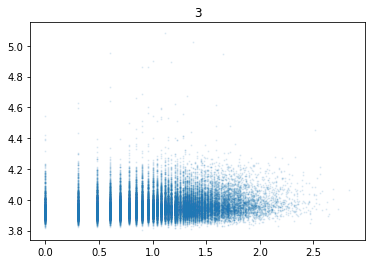


spearman 0.0779
pearson 0.0457


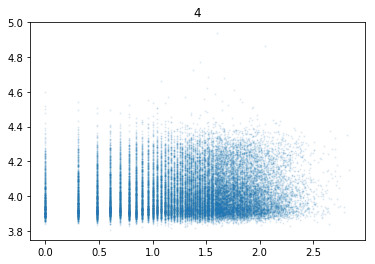


spearman 0.098
pearson 0.0609


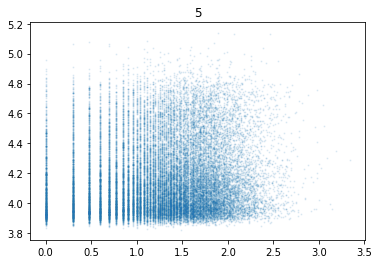


spearman 0.0896
pearson 0.0482


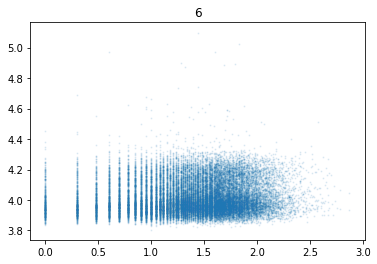


spearman 0.0955
pearson 0.0561


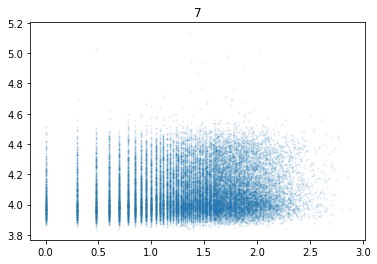


spearman 0.0756
pearson 0.0499


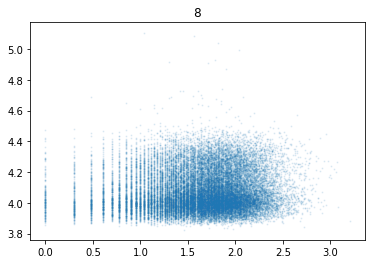


spearman 0.084
pearson 0.052


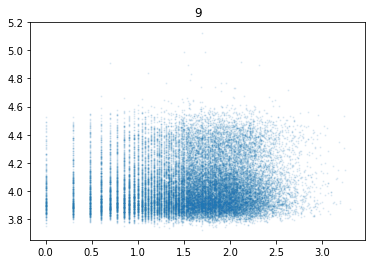


spearman 0.0776
pearson 0.053


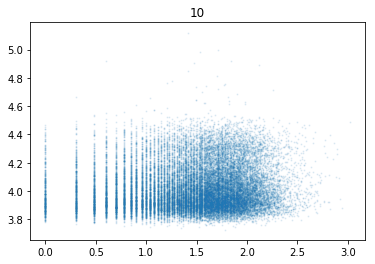


spearman 0.0782
pearson 0.0474


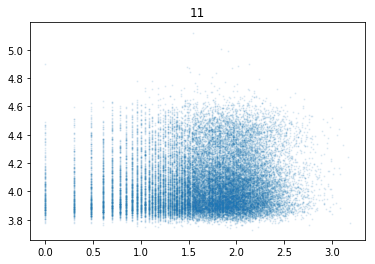


spearman 0.0927
pearson 0.0566


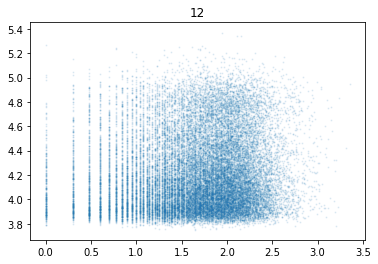


spearman 0.093
pearson 0.0563


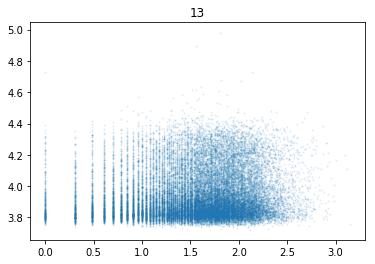


spearman 0.0292
pearson 0.0035


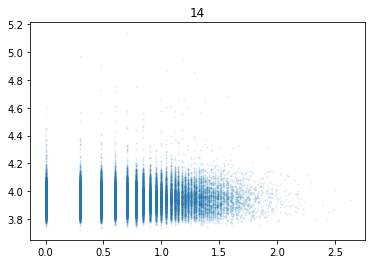


spearman 0.077
pearson 0.0534


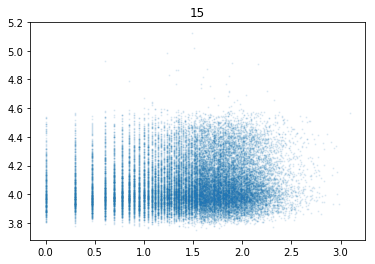


spearman 0.0533
pearson 0.0406


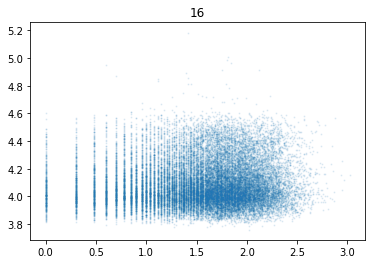


spearman 0.0646
pearson 0.0439


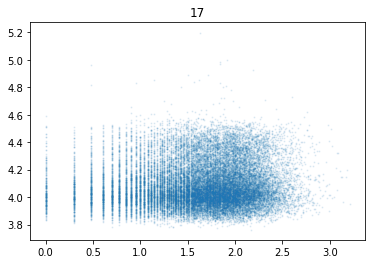

In [748]:
codebook_pth = '/bigstore/GeneralStorage/Rob/merfish/MERFISH_analysis-master/mouse/Doug/Hippocampus/HippocampusCodebookFinalPass2.txt'
codewords = pd.read_csv(codebook_pth,skiprows=3)
codewords.columns = ['name', 'id', 'barcode']
binary = np.zeros((len(codewords),18))
for y,barcode in enumerate(codewords.barcode):
    for x,b in enumerate(str(barcode).zfill(18)):
        binary[y,x]=b
binary_df = pd.DataFrame(binary,index=list(codewords['name']))
for i in full_compressed_df.columns:
    intensities = full_compressed_df[i]
    temp_gene_col = list(binary_df[binary_df[i]==1].index)
    counts = np.sum(MERFISH_clustered[temp_gene_col],axis=1)
    print('')
    print('spearman',round(spearmanr(intensities,counts)[0],4))
    print('pearson',round(pearsonr(intensities,counts)[0],4))
    plt.scatter(np.log10(counts),np.log10(intensities),s=1,alpha=0.1)
    plt.title(i)
    plt.show()

In [3]:
from fish_helpers import *
spots = pd.read_csv('/scratch/sham_m3_slide4_zach_export.csv',index_col=0)
# from fish_helpers import *
spots

/home/zach/miniconda3/envs/pyspots/lib/python3.6/site-packages/numpy/lib/arraysetops.py:569: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


,gene,ave,z,CoordX,CoordY
0,Gad2,21.937500,2,2437.541500,-3086.891000
1,Nes,25.125000,2,2594.256250,-3086.673000
2,Casp8,19.833333,2,2590.414000,-3086.618500
3,Gfra1,41.450000,2,2606.197200,-3086.629400
4,Fezf2,57.678571,2,2552.762286,-3086.439429
5,Fibcd1,28.750000,2,2615.211500,-3086.509500
6,Runx2,15.875000,2,2486.700500,-3086.073500
7,Samd5,34.375000,2,2563.491000,-3086.073500
8,Cntn5,33.000000,2,2535.096500,-3085.964500
9,Tnfaip8l3,38.125000,2,2508.282500,-3085.637500


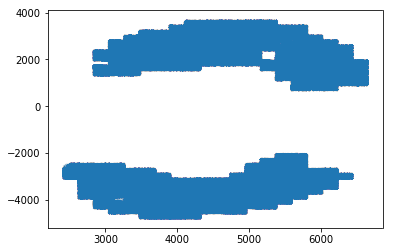

In [537]:
plt.scatter(spots.CoordX,spots.CoordY,s=0.001)
plt.show()

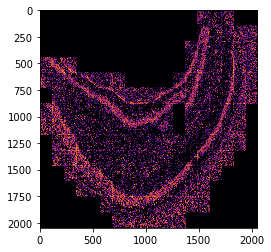

In [546]:
temp = spots[(spots.CoordY>0)] #(spots.gene==spots.gene.unique()[1])
h = np.histogram2d(np.array(temp.CoordY),np.array(temp.CoordX),bins=2048)
plt.imshow(np.log10(h[0]+1),cmap='inferno')
plt.show()

In [551]:
index = []
counts = []
for gene,cc in Counter(spots.gene).items():
    index.append(gene)
    counts.append(cc)
gene_counts_df = pd.DataFrame(counts,index)
gene_counts_df = gene_counts_df.sort_values(0,ascending=False)
gene_counts_df

,0
Fezf2,474196
Bcan,459394
Gfap,423632
Ncan,295934
Fibcd1,260216
Bptf,241097
Samm50,213438
Gja1,197342
Ntrk2,161187
Dyrk1a,158985


In [558]:
gene_counts_df.index[0]

'Fezf2'

/home/zach/miniconda3/envs/pyspots/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.


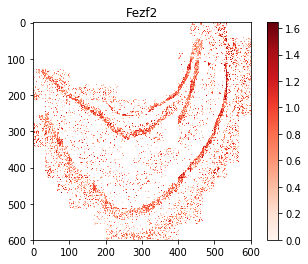

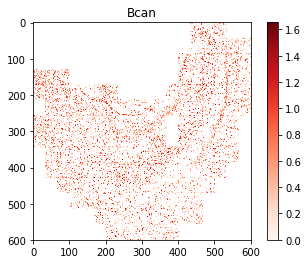

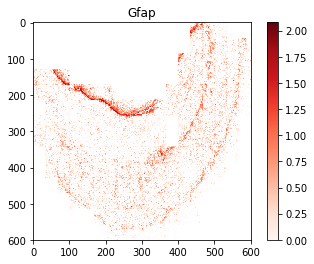

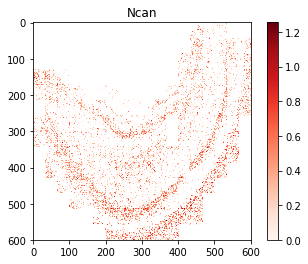

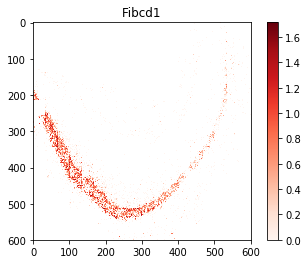

...

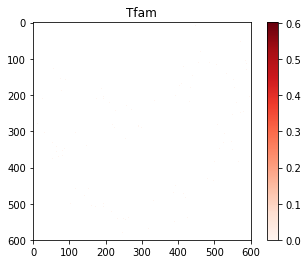

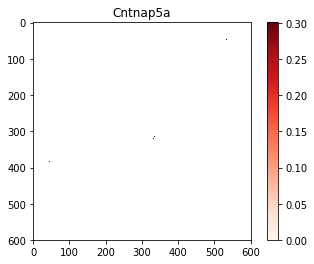

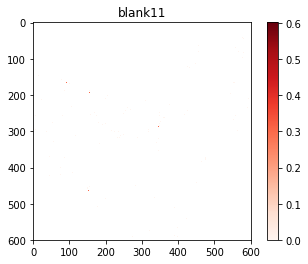

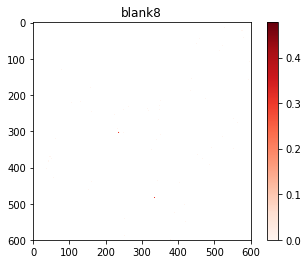

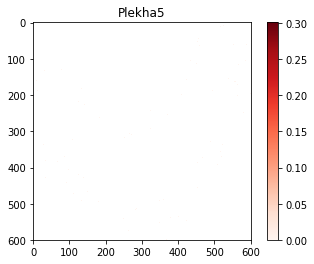

In [567]:
for gene in gene_counts_df.index:
    temp = spots[(spots.CoordY>0)&(spots.gene==gene)]
    h = np.histogram2d(np.array(temp.CoordY),np.array(temp.CoordX),bins=600)
    plt.imshow(np.log10(h[0]),cmap='Reds')
    plt.colorbar()
    plt.title(gene)
    plt.show()

/home/zach/miniconda3/envs/pyspots/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.


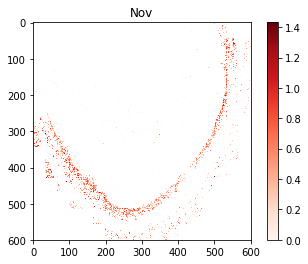

In [593]:
gene = 'Nov'
temp = spots[(spots.CoordY>0)&(spots.gene==gene)]
h = np.histogram2d(np.array(temp.CoordY),np.array(temp.CoordX),bins=600)
plt.imshow(np.log10(h[0]),cmap='Reds')
plt.colorbar()
plt.title(gene)
plt.show()

In [629]:
os.mkdir('/bigstore/GeneralStorage/Zach/CSI/Grant_Figures')

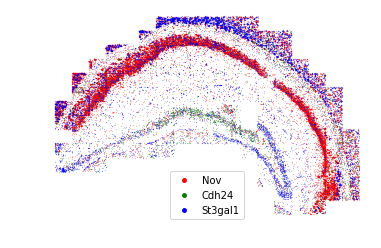

In [631]:

s = 0.01
gene = 'Nov'
temp = spots[(spots.CoordY>0)&(spots.gene==gene)]
plt.scatter(temp.CoordX,temp.CoordY,s=s,c='r',label=gene)
gene = 'Cdh24'
temp = spots[(spots.CoordY>0)&(spots.gene==gene)]
plt.scatter(temp.CoordX,temp.CoordY,s=s,c='g',label=gene)
gene = 'St3gal1'
temp = spots[(spots.CoordY>0)&(spots.gene==gene)]
plt.scatter(temp.CoordX,temp.CoordY,s=s,c='b',label=gene)
lgnd = plt.legend()#bbox_to_anchor=(0.8, 0.5, 0.5, 0.5),ncol=1)
for i in range(len(lgnd.legendHandles)):
    lgnd.legendHandles[i]._sizes = [15]
plt.axis('off')
plt.savefig('/bigstore/GeneralStorage/Zach/CSI/Grant_Figures/F1C_3Gene_scatter.pdf')
# plt.savefig('/bigstore/GeneralStorage/Zach/CSI/Grant_Figures/F1C_3Gene_scatter.eps', format='eps')
# plt.savefig('/bigstore/GeneralStorage/Zach/CSI/Grant_Figures/F1C_3Gene_scatter.svg', format='svg')
plt.show()

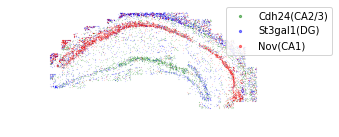

In [76]:
import matplotlib
import random
matplotlib.rcParams['svg.fonttype'] = 'none'
plt.figure(figsize=[5,2])
s = 0.01
alpha=0.5
# gene = 'Nov'
# temp = spots[(spots.CoordY>0)&(spots.gene==gene)]
# try:
#     temp = temp.loc[random.sample(list(temp.index),5000)]
# except:
#     a=1
# plt.scatter(temp.CoordX,temp.CoordY,s=s,alpha=alpha,c='r',label=gene)
gene = 'Cdh24'
temp = spots[(spots.CoordY>0)&(spots.gene==gene)]
try:
    temp = temp.loc[random.sample(list(temp.index),5000)]
except:
    a=1
plt.scatter(temp.CoordX,temp.CoordY,s=s,alpha=alpha,c='g',label=gene+'(CA2/3)')
gene = 'St3gal1'
temp = spots[(spots.CoordY>0)&(spots.gene==gene)]
try:
    temp = temp.loc[random.sample(list(temp.index),5000)]
except:
    a=1
plt.scatter(temp.CoordX,temp.CoordY,s=s,alpha=alpha,c='b',label=gene+'(DG)')
gene = 'Nov'
temp = spots[(spots.CoordY>0)&(spots.gene==gene)]
try:
    temp = temp.loc[random.sample(list(temp.index),5000)]
except:
    a=1
plt.scatter(temp.CoordX,temp.CoordY,s=s,alpha=alpha,c='r',label=gene+'(CA1)')
lgnd = plt.legend(bbox_to_anchor=(0.8, 0.5, 0.5, 0.5),ncol=1)
for i in range(len(lgnd.legendHandles)):
    lgnd.legendHandles[i]._sizes = [5]

plt.axis('off')
plt.tight_layout()
plt.savefig('/bigstore/GeneralStorage/Zach/CSI/Grant_Figures/F1C_3Gene_scatter.pdf')
plt.savefig('/bigstore/GeneralStorage/Zach/CSI/Grant_Figures/F1C_3Gene_scatter.eps', format='eps')
plt.savefig('/bigstore/GeneralStorage/Zach/CSI/Grant_Figures/F1C_3Gene_scatter.svg', format='svg')
plt.show()

In [342]:
x,y = md.image_table[md.image_table.Position=='Pos1'].XY.iloc[0]


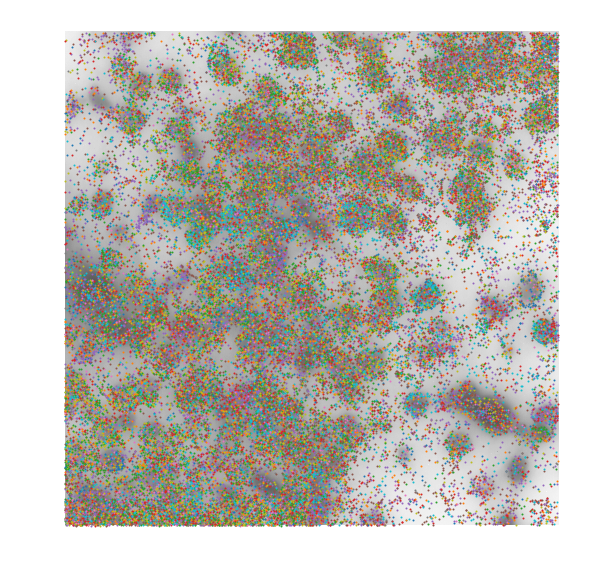

In [357]:
cameradirection = [1,1]
pixelsize = 0.109
pixel_x = (spots.CoordX-x)/(pixelsize*cameradirection[0])
pixel_y = (spots.CoordY-y)/(pixelsize*cameradirection[1])
spots['pixel_x'] = pixel_x
spots['pixel_y'] = pixel_y
x1 = 0
x2 = x1+2048
y1 = 0
y2 = y1+2048
temp_df = spots[(spots.pixel_x>=x1)&(spots.pixel_x<=x2)&(spots.pixel_y>=y1)&(spots.pixel_y<=y2)]
plt.figure(figsize=[10,10])
plt.imshow(np.log10(img),cmap='Greys')
for gene in temp_df.gene.unique():
    plt.scatter(temp_df[temp_df.gene==gene].pixel_x,temp_df[temp_df.gene==gene].pixel_y,s=1,label=gene)
# plt.legend(bbox_to_anchor=(1, 0.5, 0.5, 0.5),ncol=5)
plt.axis('off')
plt.show()

opening img_Pos1_000000032_000000000_DeepBlue_000_032.tif

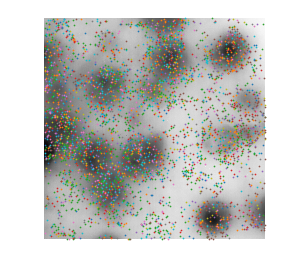

In [374]:
cameradirection = [1,1]
pixelsize = 0.109
pixel_x = (spots.CoordX-x)/(pixelsize*cameradirection[0])
pixel_y = (spots.CoordY-y)/(pixelsize*cameradirection[1])
spots['pixel_x'] = pixel_x
spots['pixel_y'] = pixel_y
stk = md.stkread(Position='Pos1',Channel='DeepBlue',acq=[i for i in md.acqnames if 'nucstain' in i]).astype('float64')
img = np.average(stk,axis=2)
x1 = 1000
x2 = x1+600
y1 = 1000
y2 = y1+600
temp_df = spots[(spots.pixel_x>=x1)&(spots.pixel_x<=x2)&(spots.pixel_y>=y1)&(spots.pixel_y<=y2)]
plt.figure(figsize=[4,4])
plt.imshow(np.log10(img[x1:x2,y1:y2]),cmap='Greys')
for gene in temp_df.gene.unique():
    plt.scatter(temp_df[temp_df.gene==gene].pixel_x-x1,temp_df[temp_df.gene==gene].pixel_y-y1,s=0.5,label=gene)
# plt.legend(bbox_to_anchor=(1, 0.5, 0.5, 0.5),ncol=5)
plt.axis('off')
plt.tight_layout()
plt.show()

opening img_Pos1_000000032_000000000_FarRed_000_032.tif

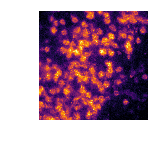

In [421]:
stk = md.stkread(Position='Pos1',Channel='FarRed',acq=acq)#.astype('float64')
# img = np.average(stk,axis=2)
img = stk[:,:,15]
temp = img.copy()
min_thresh = np.percentile(temp.ravel(),1) 
temp[temp<min_thresh]=min_thresh
max_thresh = np.percentile(temp.ravel(),99.9) 
temp[temp>max_thresh]=max_thresh
plt.figure(figsize=[2,2])
plt.imshow(temp,cmap='inferno')
# plt.colorbar()
plt.axis('off')
plt.show()

In [44]:
spots

,gene,ave,z,CoordX,CoordY,cell,distance,pos,pixel_x,pixel_y
0,Gad2,21.937500,2,2437.541500,-3086.891000,15561,6.370279,Pos1,243.500000,1.000000
1,Nes,25.125000,2,2594.256250,-3086.673000,29263,12.835393,Pos1,1681.250000,3.000000
2,Casp8,19.833333,2,2590.414000,-3086.618500,26933,11.797205,Pos1,1646.000000,3.500000
3,Gfra1,41.450000,2,2606.197200,-3086.629400,19727,8.652330,Pos1,1790.800000,3.400000
4,Fezf2,57.678571,2,2552.762286,-3086.439429,18880,9.265749,Pos1,1300.571429,5.142857
5,Fibcd1,28.750000,2,2615.211500,-3086.509500,19727,8.864461,Pos1,1873.500000,4.500000
6,Runx2,15.875000,2,2486.700500,-3086.073500,22147,5.684166,Pos1,694.500000,8.500000
7,Samd5,34.375000,2,2563.491000,-3086.073500,18880,16.770466,Pos1,1399.000000,8.500000
8,Cntn5,33.000000,2,2535.096500,-3085.964500,20726,5.075030,Pos1,1138.500000,9.500000
9,Tnfaip8l3,38.125000,2,2508.282500,-3085.637500,29128,5.559781,Pos1,892.500000,12.500000


opening img_Pos1_000000015_000000000_Orange_000_015.tif

/home/zach/miniconda3/envs/pyspots/lib/python3.6/site-packages/scipy/ndimage/interpolation.py:611: UserWarning: From scipy 0.13.0, the output shape of zoom() is calculated with round() instead of int() - for these inputs the size of the returned array has changed.
  "the returned array has changed.", UserWarning)


opening img_Pos1_000000015_000000000_Orange_000_015.tif

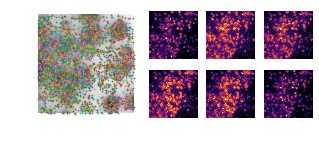

In [64]:
import matplotlib.gridspec as gridspec
from scipy import ndimage
pos='Pos1'
import matplotlib
matplotlib.rcParams['svg.fonttype'] = 'none'
# stk = md.stkread(Position=pos,Channel='DeepBlue',acq=[i for i in md.acqnames if 'nucstain' in i]).astype('float64')
img = np.average(stk,axis=2)
x1 = 1000
x2 = x1+600
y1 = 1000
y2 = y1+600
temp_df = spots[(spots.pixel_x>=x1)&
                (spots.pixel_x<=x2)&
                (spots.pixel_y>=y1)&
                (spots.pixel_y<=y2)&
                (spots.pos==pos)]
plt.figure(figsize=[5,2])
gs1 = gridspec.GridSpec(2,5)
gs1.update(wspace=0, hspace=0) # set the spacing between axes. 
a1 = plt.subplot2grid((2,5),(0,0),rowspan = 2,colspan = 2)
a1.imshow(np.log10(img[x1:x2,y1:y2]),cmap='Greys')
a1.set_aspect('auto')
# a1.subplots_adjust(wspace=0, hspace=0)
a1.axis('off')
for gene in temp_df.gene.unique():
    a1.scatter(temp_df[temp_df.gene==gene].pixel_x-x1,temp_df[temp_df.gene==gene].pixel_y-y1,s=0.5,label=gene)
x = 2
y = 0
measurement = 1
axs = {}
for acq in md.acqnames:
    if x>4:
        continue
    if 'nucstain' in acq:
        continue
    if 'acq' in acq:
        continue
    if acq == md.acqnames[2]:
        continue
    y = 0
    for color in ['FarRed','Orange']:
        key = str(x)+','+str(y)
        axs[key] = plt.subplot2grid((2,5),(y,x))
        img = md.stkread(Position=pos,Channel=color,acq=acq,Zindex=15)[:,:,0]
        img = ndimage.interpolation.zoom(img,.2)
        min_thresh = np.percentile(img.ravel(),1) 
        img[img<min_thresh]=min_thresh
        max_thresh = np.percentile(img.ravel(),99.9) 
        img[img>max_thresh]=max_thresh
        axs[key].imshow(img,cmap='inferno')
        axs[key].set_aspect('equal')
        axs[key].axis('off')
#         axs[key].set_title('bit '+str(measurement))
        y+=1
        measurement+=1
    x+=1
# plt.tight_layout()
plt.savefig('/bigstore/GeneralStorage/Zach/CSI/Grant_Figures/F7ab_MERFISH_20x.pdf')
plt.savefig('/bigstore/GeneralStorage/Zach/CSI/Grant_Figures/F7ab_MERFISH_20x.eps',format='eps')
plt.savefig('/bigstore/GeneralStorage/Zach/CSI/Grant_Figures/F7ab_MERFISH_20x.svg',format='svg')
plt.show()


In [ ]:
import matplotlib.gridspec as gridspec
stk = md.stkread(Position='Pos1',Channel='DeepBlue',acq=[i for i in md.acqnames if 'nucstain' in i]).astype('float64')
img = np.average(stk,axis=2)
x1 = 1000
x2 = x1+600
y1 = 1000
y2 = y1+600
temp_df = spots[(spots.pixel_x>=x1)&(spots.pixel_x<=x2)&(spots.pixel_y>=y1)&(spots.pixel_y<=y2)]
plt.figure(figsize=[12,4])
gs1 = gridspec.GridSpec(2,6)
gs1.update(wspace=0, hspace=0) # set the spacing between axes. 
a1 = plt.subplot2grid((2,6),(0,0),rowspan = 2,colspan = 2)
a1.imshow(np.log10(img[x1:x2,y1:y2]),cmap='Greys')
a1.set_aspect('auto')
# a1.subplots_adjust(wspace=0, hspace=0)
a1.axis('off')
for gene in temp_df.gene.unique():
    a1.scatter(temp_df[temp_df.gene==gene].pixel_x-x1,temp_df[temp_df.gene==gene].pixel_y-y1,s=0.5,label=gene)
x = 2
y = 0
measurement = 1
axs = {}
for acq in md.acqnames:
    if x>5:
        continue
    if 'nucstain' in acq:
        continue
    if 'acq' in acq:
        continue
    if acq == md.acqnames[2]:
        continue
    y = 0
    for color in ['FarRed','Orange']:
        key = str(x)+','+str(y)
        axs[key] = plt.subplot2grid((2,6),(y,x))
        img = md.stkread(Position='Pos1',Channel=color,acq=acq,Zindex=15)[:,:,0]
        min_thresh = np.percentile(img.ravel(),1) 
        img[img<min_thresh]=min_thresh
        max_thresh = np.percentile(img.ravel(),99.9) 
        img[img>max_thresh]=max_thresh
        axs[key].imshow(img,cmap='inferno')
        axs[key].set_aspect('auto')
        axs[key].axis('off')
        axs[key].set_title('bit '+str(measurement))
        y+=1
        measurement+=1
    x+=1
plt.savefig('/bigstore/GeneralStorage/Zach/CSI/Grant_Figures/F7ab_MERFISH_20x.pdf')
# plt.savefig('/bigstore/GeneralStorage/Zach/CSI/Grant_Figures/F7ab_MERFISH_20x.eps',format='eps')
# plt.savefig('/bigstore/GeneralStorage/Zach/CSI/Grant_Figures/F7ab_MERFISH_20x.svg',format='svg')
plt.show()


In [10]:
spots = pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/spots.csv.gz',index_col=0)
spots

/home/zach/miniconda3/envs/pyspots/lib/python3.6/site-packages/numpy/lib/arraysetops.py:569: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


,gene,ave,z,CoordX,CoordY,cell,distance,pos,pixel_x,pixel_y
0,Gad2,21.937500,2,2437.541500,-3086.891000,15561,6.370279,Pos1,243.500000,1.000000
1,Nes,25.125000,2,2594.256250,-3086.673000,29263,12.835393,Pos1,1681.250000,3.000000
2,Casp8,19.833333,2,2590.414000,-3086.618500,26933,11.797205,Pos1,1646.000000,3.500000
3,Gfra1,41.450000,2,2606.197200,-3086.629400,19727,8.652330,Pos1,1790.800000,3.400000
4,Fezf2,57.678571,2,2552.762286,-3086.439429,18880,9.265749,Pos1,1300.571429,5.142857
5,Fibcd1,28.750000,2,2615.211500,-3086.509500,19727,8.864461,Pos1,1873.500000,4.500000
6,Runx2,15.875000,2,2486.700500,-3086.073500,22147,5.684166,Pos1,694.500000,8.500000
7,Samd5,34.375000,2,2563.491000,-3086.073500,18880,16.770466,Pos1,1399.000000,8.500000
8,Cntn5,33.000000,2,2535.096500,-3085.964500,20726,5.075030,Pos1,1138.500000,9.500000
9,Tnfaip8l3,38.125000,2,2508.282500,-3085.637500,29128,5.559781,Pos1,892.500000,12.500000


opening img_Pos1_000000032_000000000_DeepBlue_000_032.tif4554
opening img_Pos1_000000015_000000000_Orange_000_015.tif

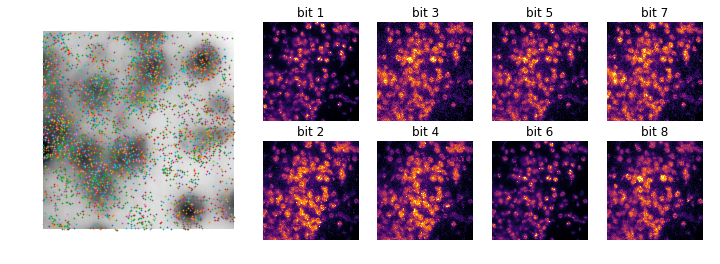

In [12]:
import matplotlib.gridspec as gridspec
stk = md.stkread(Position='Pos1',Channel='DeepBlue',acq=[i for i in md.acqnames if 'nucstain' in i]).astype('float64')
img = np.average(stk,axis=2)
x1 = 1000
x2 = x1+600
y1 = 1000
y2 = y1+600
temp_df = spots[(spots.pos=='Pos1')&(spots.pixel_x>=x1)&(spots.pixel_x<=x2)&(spots.pixel_y>=y1)&(spots.pixel_y<=y2)]
plt.figure(figsize=[12,4])
gs1 = gridspec.GridSpec(2,6)
gs1.update(wspace=0, hspace=0) # set the spacing between axes. 
a1 = plt.subplot2grid((2,6),(0,0),rowspan = 2,colspan = 2)
a1.imshow(np.log10(img[x1:x2,y1:y2]),cmap='Greys')
a1.set_aspect('auto')
# a1.subplots_adjust(wspace=0, hspace=0)
a1.axis('off')
print(len(temp_df))
for gene in temp_df.gene.unique():
    a1.scatter(temp_df[temp_df.gene==gene].pixel_x-x1,temp_df[temp_df.gene==gene].pixel_y-y1,s=0.5,label=gene)
x = 2
y = 0
measurement = 1
axs = {}
for acq in md.acqnames:
    if x>5:
        continue
    if 'nucstain' in acq:
        continue
    if 'acq' in acq:
        continue
    if acq == md.acqnames[2]:
        continue
    y = 0
    for color in ['FarRed','Orange']:
        key = str(x)+','+str(y)
        axs[key] = plt.subplot2grid((2,6),(y,x))
        img = md.stkread(Position='Pos1',Channel=color,acq=acq,Zindex=15)[:,:,0]
        min_thresh = np.percentile(img.ravel(),1) 
        img[img<min_thresh]=min_thresh
        max_thresh = np.percentile(img.ravel(),99.9) 
        img[img>max_thresh]=max_thresh
        axs[key].imshow(img,cmap='inferno')
        axs[key].set_aspect('auto')
        axs[key].axis('off')
        axs[key].set_title('bit '+str(measurement))
        y+=1
        measurement+=1
    x+=1
plt.savefig('/bigstore/GeneralStorage/Zach/CSI/Grant_Figures/F7ab_MERFISH_20x.pdf')
# plt.savefig('/bigstore/GeneralStorage/Zach/CSI/Grant_Figures/F7ab_MERFISH_20x.eps',format='eps')
# plt.savefig('/bigstore/GeneralStorage/Zach/CSI/Grant_Figures/F7ab_MERFISH_20x.svg',format='svg')
plt.show()


In [320]:
import pickle
import pandas as pd
matrix = pickle.load(open('/bigstore/binfo/mouse/Hippocampus/TBI.SHAM.countdata.with.celltypes.normalized.pkl','rb'))
latent = pd.read_csv('/bigstore/binfo/mouse/Hippocampus/TBI.SHAM.countdata.with.celltypes.latent.csv.gz',index_col=0)
genes = pd.read_csv('/bigstore/binfo/mouse/Hippocampus/TBI.SHAM.countdata.with.celltypes.genes.csv',index_col=0)
info_df = pd.read_csv('/bigstore/binfo/mouse/Hippocampus/TBI.SHAM.countdata.with.celltypes.info_df.csv',index_col=0)


In [321]:
matrix_df = pd.DataFrame(matrix.T,index=genes.index,columns=info_df.index)

In [323]:
codebook_pth = '/bigstore/GeneralStorage/Rob/merfish/MERFISH_analysis-master/mouse/Doug/Hippocampus/HippocampusCodebookFinalPass2.txt'
codewords = pd.read_csv(codebook_pth,  # Warning - file import
                       skiprows=3)
codewords.columns = ['name', 'id', 'barcode']
codewords

,name,id,barcode
0,Ntrk2,ENSMUST00000109838,10000101010000
1,Creb1,ENSMUST00000087366,100010001100000
2,Pparg,ENSMUST00000171644,1010000010010000
3,Tfam,ENSMUST00000092430,100100000000011000
4,Ckmt1,ENSMUST00000000317,1001000001010
5,Igf1,ENSMUST00000095360,100010000010000010
6,Insr,ENSMUST00000091291,100100010000000001
7,Thra,ENSMUST00000064187,10000010000011000
8,Mapt,ENSMUST00000106992,1100100100000000
9,Gfap,ENSMUST00000067444,1001110000


In [324]:
probed_expression_matrix = matrix_df.loc[list(codewords.name)]
probed_expression_matrix.head()

/home/zach/miniconda3/envs/pyspots/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  """Entry point for launching an IPython kernel.


,S1Hip_CCTTGCCACACT_ODC,S1Hip_TTCTATTCGTAG_ODC,S1Hip_TTGGGCCCACCG_ODC,S1Hip_ATGTACGCCGTG_ODC,S1Hip_CCAGAATAATTT_ODC,S1Hip_CCGCTCAAGTCC_ODC,S1Hip_GGAGGATTGGGT_ODC,S1Hip_AGTCACTGTTTA_ODC,S1Hip_TAAAACCTATCG_ODC,S1Hip_CCGTCCCGAGTT_ODC,...,TBI5Hip_TCCTGAGACGCT_EPEN,TBI5Hip_TTGCGCAAAACG_EPEN,TBI5Hip_ACGCCGAGTTGC_EPEN,TBI5Hip_CAGCATATGGCG_EPEN,TBI5Hip_GACATCATTCAT_EPEN,TBI5Hip_GGTATTGACACC_EPEN,TBI5Hip_TCCCACGCCAAC_EPEN,TBI5Hip_TTCCTGTAGACC_EPEN,TBI5Hip_ATTTAATTGAGC_EPEN,TBI5Hip_ATCCCTCGCAGC_EPEN
Ntrk2,0.000033,2.083089e-05,3.896844e-05,0.000039,0.000031,0.000057,0.000031,0.000053,0.000044,0.000027,...,0.000972,0.000479,0.000531,0.000578,0.000505,0.000808,0.000530,0.000470,0.000639,0.000535
Creb1,0.000030,3.951838e-05,3.854059e-05,0.000034,0.000037,0.000034,0.000039,0.000032,0.000037,0.000030,...,0.000031,0.000032,0.000027,0.000025,0.000054,0.000040,0.000029,0.000033,0.000043,0.000035
Pparg,0.000004,4.273179e-06,5.608836e-06,0.000004,0.000006,0.000006,0.000006,0.000006,0.000004,0.000004,...,0.000009,0.000005,0.000003,0.000003,0.000027,0.000011,0.000006,0.000004,0.000008,0.000006
Tfam,0.000042,4.626540e-05,4.923858e-05,0.000056,0.000050,0.000062,0.000048,0.000061,0.000050,0.000044,...,0.000111,0.000128,0.000159,0.000187,0.000112,0.000106,0.000165,0.000153,0.000163,0.000083
Ckmt1,0.000002,9.150499e-07,8.750550e-07,0.000002,0.000003,0.000003,0.000002,0.000002,0.000002,0.000002,...,0.000006,0.000004,0.000005,0.000008,0.000012,0.000003,0.000007,0.000009,0.000009,0.000007


In [325]:
variable_genes = list(matrix_df.index)
for i in list(codewords.name):
    if not i in variable_genes:
        print(i)

Arhgap45
Emsy
Epb41l4b
Zfp950


In [326]:
binary = np.zeros((len(probed_expression_matrix),18))
for y,barcode in enumerate(codewords.barcode):
    for x,b in enumerate(str(barcode).zfill(18)):
        binary[y,x]=b
binary

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 1., 0., 0.]])

In [327]:
compressed = pd.DataFrame(index=matrix_df.columns)
temp_matrix = np.array(probed_expression_matrix)
for i in range(18):
    compressed[i] = np.nansum(np.multiply(temp_matrix,binary[:,i][...,None]),axis=0)
compressed

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
S1Hip_CCTTGCCACACT_ODC,0.012482,0.005789,0.009033,0.008862,0.006096,0.010212,0.004171,0.007589,0.003029,0.002964,0.001329,0.006154,0.007473,0.003674,0.006936,0.004815,0.001944,0.001434
S1Hip_TTCTATTCGTAG_ODC,0.017620,0.004561,0.008725,0.013138,0.006982,0.015158,0.005140,0.009812,0.002647,0.003640,0.001283,0.005138,0.011159,0.003391,0.005838,0.005672,0.002619,0.001436
S1Hip_TTGGGCCCACCG_ODC,0.013316,0.004405,0.007607,0.009660,0.006214,0.010512,0.004143,0.008007,0.003045,0.003445,0.001564,0.004694,0.008270,0.003830,0.005314,0.005565,0.002283,0.001791
S1Hip_ATGTACGCCGTG_ODC,0.014806,0.003807,0.007677,0.010183,0.006778,0.012458,0.004795,0.009166,0.002839,0.003124,0.001340,0.004203,0.008626,0.003360,0.004916,0.005673,0.002613,0.001582
S1Hip_CCAGAATAATTT_ODC,0.012594,0.004159,0.007601,0.009427,0.005988,0.010730,0.004478,0.007683,0.002926,0.003536,0.001526,0.004561,0.007889,0.003493,0.005371,0.005058,0.002261,0.001693
S1Hip_CCGCTCAAGTCC_ODC,0.011272,0.005772,0.008288,0.008870,0.004968,0.010113,0.004537,0.006952,0.003690,0.003336,0.001528,0.006187,0.007913,0.004395,0.007287,0.004095,0.002355,0.001833
S1Hip_GGAGGATTGGGT_ODC,0.012980,0.004436,0.008085,0.009151,0.006261,0.010636,0.004321,0.008209,0.002768,0.003215,0.001413,0.004783,0.007587,0.003437,0.005476,0.005194,0.002205,0.001557
S1Hip_AGTCACTGTTTA_ODC,0.016052,0.005112,0.008339,0.013125,0.005919,0.013940,0.004296,0.007290,0.003163,0.003565,0.001668,0.005690,0.011534,0.003661,0.006562,0.004871,0.002163,0.001756
S1Hip_TAAAACCTATCG_ODC,0.014487,0.004717,0.008235,0.010807,0.006450,0.011425,0.004036,0.007879,0.002952,0.003482,0.001615,0.005110,0.009110,0.003716,0.005778,0.005613,0.002103,0.001843
S1Hip_CCGTCCCGAGTT_ODC,0.015566,0.004953,0.008528,0.011615,0.006481,0.013112,0.004681,0.008621,0.002762,0.003357,0.001312,0.005322,0.009917,0.003338,0.006161,0.005364,0.002237,0.001407


In [ ]:
def img2stage_coordinates(spotcalls,md,pixelsize=0.109,cameradirection=[-1,1],verbose=False):
    """
    RKF Comments - md and path can be combined. if md isinstance(str) then load metadata else 
    assert it isinstance(Metadata) and continue
    
    camera pixels is hardcoded
    
    CoordX and CoordY are not descriptive enough names to know difference between them and 
    other x,y. Candidate suggestion either stageX/Y or globalXY
    """
    if isinstance(md, str):
            from metadata import Metadata
            md = Metadata(md)
    X = []
    Y = []
    for pos in spotcalls.posname.unique():
        if verbose==True:
            print(pos)
        coordX,coordY = md.image_table[md.image_table.Position==pos].XY.iloc[0]
        pos_temp = spotcalls[spotcalls.posname==pos]
#         pos_centroid = pos_temp.centroid
#         centroids = np.stack(pos_temp.centroid, axis=0)
#         centroids = centroids*pixelsize*cameradirection*(coordY, coordX)
        # The below for loop can be replaced with a numpy broadcasted operation
        for yx in pos_centroid:
            rx = yx[1]
            ry = yx[0]
            x = rx*pixelsize*cameradirection[0]+coordX
            y = ry*pixelsize*cameradirection[1]+coordY
            X.append(x)
            Y.append(y)
    spotcalls['CoordX'] = X
    spotcalls['CoordY'] = Y
    return spotcalls


In [478]:
cameradirection

[1, 1]

In [476]:
MERFISH_stage = pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/Hippocampus_sham_m3_segmented_data/Merged.Cells.stage.Coords.csv.gz')
cameradirection=[1,1]
pixelsize = 0.109
index = []
X = []
Y = []
for pos in MERFISH.pos.unique():
    print(pos)
    coordX,coordY = md.image_table[md.image_table.Position==pos].XY.iloc[0]
    pos_temp = MERFISH[MERFISH.pos==pos]
    for i in pos_temp.index:
        index.append(i)
        x = pos_temp.loc[i].x*pixelsize*cameradirection[0]+coordX
        y = pos_temp.loc[i].y*pixelsize*cameradirection[1]+coordY
        X.append(x)
        Y.append(y)
MERFISH_stage['stage_x'] = X
MERFISH_stage['stage_y'] = Y

Pos1
Pos10
Pos100
Pos101
Pos102
Pos103
Pos104
Pos105
Pos106
Pos107
Pos108
Pos109
Pos11
Pos110
Pos111
Pos112
Pos113
Pos114
Pos115
Pos116
Pos117
Pos118
Pos119
Pos12
Pos120
Pos121
Pos122
Pos123
Pos124
Pos125
Pos126
Pos127
Pos128
Pos129
Pos13
Pos130
Pos131
Pos132
Pos133
Pos134
Pos135
Pos136
Pos137
Pos138
Pos139
Pos14
Pos140
Pos141
Pos142
Pos143
Pos144
Pos145
Pos146
Pos147
Pos148
Pos149
Pos15
Pos150
Pos151
Pos152
Pos153
Pos154
Pos155
Pos156
Pos157
Pos158
Pos159
Pos16
Pos160
Pos161
Pos162
Pos163
Pos164
Pos165
Pos166
Pos167
Pos168
Pos169
Pos17
Pos170
Pos171
Pos172
Pos173
Pos174
Pos175
Pos176
Pos177
Pos178
Pos179
Pos18
Pos180
Pos181
Pos182
Pos183
Pos184
Pos185
Pos186
Pos187
Pos188
Pos189
Pos19
Pos190
Pos191
Pos192
Pos193
Pos194
Pos195
Pos196
Pos197
Pos198
Pos199
Pos2
Pos20
Pos200
Pos201
Pos202
Pos203
Pos204
Pos205
Pos206
Pos207
Pos21
Pos210
Pos211
Pos212
Pos213
Pos214
Pos215
Pos216
Pos217
Pos218
Pos219
Pos220
Pos221
Pos222
Pos223
Pos224
Pos225
Pos226
Pos227
Pos228
Pos229
Pos23
Pos230
Pos231
Po

In [479]:
coordinates_df = pd.DataFrame(index = index)
coordinates_df['stage_x'] = X
coordinates_df['stage_y'] = Y
coordinates_df

,stage_x,stage_y
X1,2411.000,-2996.203
X2,2411.000,-2949.660
X3,2415.578,-2897.667
X4,2421.791,-2878.919
X5,2412.308,-2918.595
X6,2414.597,-3052.883
X7,2419.829,-2941.158
X8,2426.914,-2970.370
X9,2424.407,-3087.000
X10,2427.786,-3009.719


In [480]:
MERFISH_stage = pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/Hippocampus_sham_m3_segmented_data/Merged.Cells.stage.Coords.csv.gz')
MERFISH_stage['stage_x'] = X
MERFISH_stage['stage_y'] = Y
MERFISH_stage

,x,y,z,Sema5a,Ttyh2,Tnfaip8l3,Cacna2d1,Ncan,Spry2,Epb41l4b,...,Myo3a,Sap30bpos,Rassf3,Prox1,Grm2,Casp8,Plekha5,Selplg,stage_x,stage_y
X1,2320.203,-3087.000,10,1,2,1,1,3,1,1,...,0,0,0,0,0,0,0,0,2411.000,-2996.203
X2,2273.660,-3087.000,10,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,2411.000,-2949.660
X3,2221.667,-3082.422,10,0,0,0,1,1,1,1,...,0,0,0,0,0,0,0,0,2415.578,-2897.667
X4,2202.919,-3076.209,10,0,0,0,0,1,0,2,...,0,0,0,0,0,0,0,0,2421.791,-2878.919
X5,2242.595,-3085.692,10,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,2412.308,-2918.595
X6,2376.883,-3083.403,10,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,2414.597,-3052.883
X7,2265.158,-3078.171,10,0,0,0,0,0,1,2,...,0,0,0,0,0,0,0,0,2419.829,-2941.158
X8,2294.370,-3071.086,10,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,2426.914,-2970.370
X9,2411.000,-3073.593,10,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,2424.407,-3087.000
X10,2333.719,-3070.214,10,0,0,0,0,0,1,1,...,0,0,0,0,0,0,0,0,2427.786,-3009.719


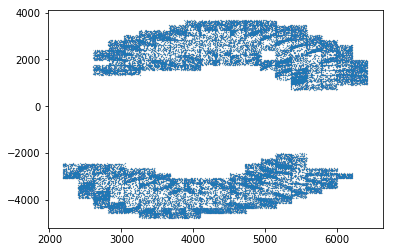

In [333]:
MERFISH_stage = pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/Hippocampus_sham_m3_segmented_data/Merged.Cells.stage.Coords.csv.gz')
plt.scatter(MERFISH_stage.x,MERFISH_stage.y,s=0.001)
plt.show()

In [31]:
predicted_cells = pd.read_csv('/home/rlittman/Hippocampus_sham_m3_segmented_data/sham.merfish.predicted.cells.csv.gz')
predicted_metadata = pd.read_csv('/home/rlittman/Hippocampus_sham_m3_segmented_data/sham.merfish.predicted.cells.metadata.csv.gz')
predicted_metadata

,x_coord,y_coord,z_coord,predicted.id,prob_prediction
0,2501.797,-3087.000,10,NEU,0.552948
1,2600.333,-3082.422,10,NEU,0.764714
2,2619.081,-3076.209,10,NEU,0.737855
3,2579.405,-3085.692,10,NEU,0.925125
4,2556.842,-3078.171,10,ASC,0.480022
5,2527.630,-3071.086,10,NEU,0.756002
6,2473.348,-3069.778,10,ASC,0.460729
7,2443.809,-3069.233,10,NEU,0.806272
8,2546.487,-3067.380,10,NEU,0.542372
9,2605.129,-3064.764,10,NEU,0.737783


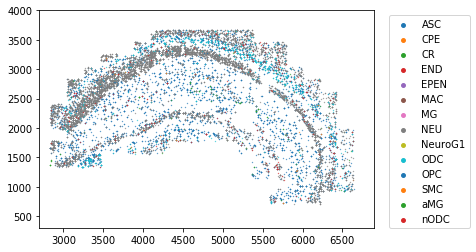

In [33]:
cts = list(predicted_metadata['predicted.id'].unique())
cts.sort()
for ct in cts:
    temp_df = predicted_metadata[predicted_metadata['predicted.id']==ct]
    plt.scatter(temp_df.x_coord,temp_df.y_coord,s=0.1,label=ct)
# plt.legend(bbox_to_anchor=(0.8, 0.5, 0.5, 0.5))
# lgnd = plt.legend(bbox_to_anchor=(0., 0.5, 0.5, 0.5),ncol=2)
lgnd = plt.legend(bbox_to_anchor=(0.8, 0.5, 0.5, 0.5),ncol=1)
for i in range(len(lgnd.legendHandles)):
    lgnd.legendHandles[i]._sizes = [15]
plt.ylim([300,4000])
plt.xlim([2700,6900])
# plt.axis('off')
plt.show()

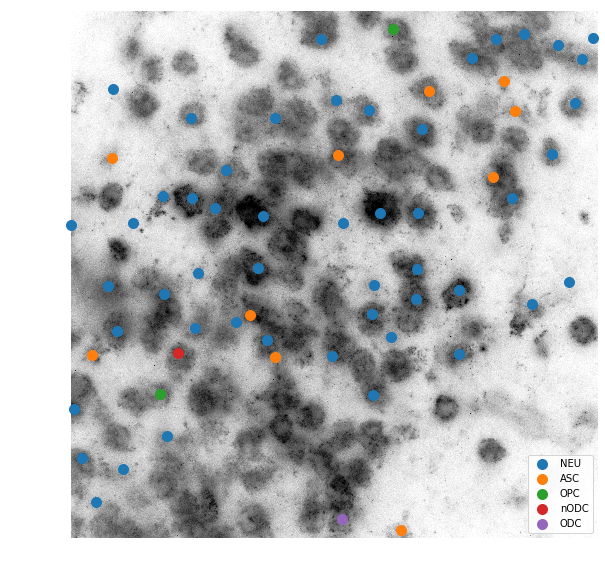

In [502]:
cameradirection = [1,1]
pixelsize = 0.109
temp = predicted_metadata.copy()
x,y = md.image_table[md.image_table.Position=='Pos1'].XY.iloc[0]
pixel_x = (predicted_metadata.x_coord-x)/(pixelsize*cameradirection[0])
pixel_y = (predicted_metadata.y_coord-y)/(pixelsize*cameradirection[1])
temp['pixel_x'] = pixel_y
temp['pixel_y'] = pixel_x
x1 = 0
x2 = x1+2048
y1 = 0
y2 = y1+2048
temp_df = temp[(temp.z_coord==10)&(temp.pixel_x>=x1)&(temp.pixel_x<=x2)&(temp.pixel_y>=y1)&(temp.pixel_y<=y2)]
plt.figure(figsize=[10,10])
plt.imshow(np.log10(img),cmap='Greys')
for gene in temp_df['predicted.id'].unique():
    plt.scatter(temp_df[temp_df['predicted.id']==gene].pixel_x,temp_df[temp_df['predicted.id']==gene].pixel_y,s=100,label=gene)
plt.legend(loc='lower right')#bbox_to_anchor=(0.75, 0.5, 0.5, 0.5),ncol=1)
plt.axis('off')
plt.show()

In [35]:
from scipy.stats import pearsonr
from segmentation_3D import *
def convert2compressed(temp_df,md,blur=40):
    bitmap = [('RS0095_cy5', 'hybe1', 'FarRed'), ('RS0109_cy5', 'hybe3', 'FarRed'),
              ('RS0175_cy5', 'hybe5', 'FarRed'), ('RS0237_cy5', 'hybe7', 'FarRed'),
              ('RS0307_cy5', 'hybe2', 'FarRed'), ('RS0332_cy5', 'hybe4', 'FarRed'),
              ('RSN9927.0_cy5', 'hybe8', 'FarRed'), ('RSN2336.0_cy5', 'hybe6', 'FarRed'), 
              ('RSN1807.0_cy5', 'hybe9', 'FarRed'),
              ('RS0384_atto565', 'hybe4', 'Orange'), ('RS0406_atto565', 'hybe5', 'Orange'),
              ('RS0451_atto565', 'hybe3', 'Orange'), ('RS0468_atto565', 'hybe2', 'Orange'),
              ('RS0548_atto565', 'hybe1', 'Orange'), ('RS64.0_atto565', 'hybe7', 'Orange'),
              ('RSN4287.0_atto565', 'hybe6', 'Orange'), 
              ('RSN1252.0_atto565', 'hybe9', 'Orange'), ('RSN9535.0_atto565', 'hybe8', 'Orange')]
    pos = temp_df.pos.iloc[0]
    compressed_measurement = np.zeros((len(temp_df),18))
    for bit,bit_data in enumerate(bitmap):
        rp,hybe,color = bit_data
        acq = [i for i in md.acqnames if hybe in i]
        stk = md.stkread(Position=pos,Channel=color,acq=acq).astype('float64')
        img = np.sum(stk,axis=2)
        blurred = filters.gaussian(img, int(blur))
        for i,cell in enumerate(temp_df.index):
            y = temp_df['pixel_x'].loc[cell]
            x = temp_df['pixel_y'].loc[cell]
            compressed_measurement[i,bit] = blurred[int(x),int(y)]
    compressed_df = pd.DataFrame(compressed_measurement,index=temp_df.index)
    return compressed_df
cell_info_df = pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/cell_info_df.csv.gz',index_col=0)

import tqdm.notebook as tqdm
from multiprocessing import Pool
import sys
from functools import partial
sys.stdout.flush()
pfunc = partial(convert2compressed,md=md,blur=40)
Input = [cell_info_df[cell_info_df.pos==pos] for pos in cell_info_df.pos.unique()]
temp_dfs = []
with Pool(30) as p:
    for temp_df in tqdm.tqdm(p.imap(pfunc,Input,chunksize=1),total=len(Input)):
        temp_dfs.append(temp_df)
sys.stdout.flush()
compressed_df2 = pd.concat(temp_dfs)
compressed_df2.to_csv('/bigstore/GeneralStorage/Zach/CSI/compressed_df2.csv.gz',compression='gzip')
compressed_df2

opening img_Pos132_000000006_000000000_FarRed_000_006.tif

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



opening img_Pos49_000000029_000000000_Orange_000_029.tiff

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



opening img_Pos163_000000008_000000000_Orange_000_008.tif

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [40]:
codebook_pth = '/bigstore/GeneralStorage/Rob/merfish/MERFISH_analysis-master/mouse/Doug/Hippocampus/HippocampusCodebookFinalPass2.txt'
codewords = pd.read_csv(codebook_pth,skiprows=3)
codewords.columns = ['name', 'id', 'barcode']
binary = np.zeros((len(codewords),18))
for y,barcode in enumerate(codewords.barcode):
    for x,b in enumerate(str(barcode).zfill(18)):
        binary[y,x]=b
binary_df = pd.DataFrame(binary,index=list(codewords['name']))


spearman 0.7454
pearson 0.6374


/home/zach/miniconda3/envs/pyspots/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: divide by zero encountered in log10
  del sys.path[0]


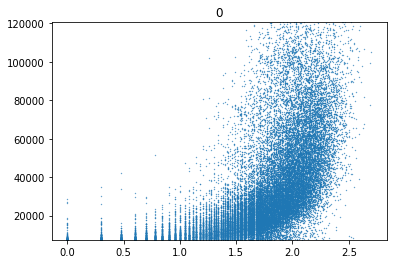


spearman 0.5336
pearson 0.3752


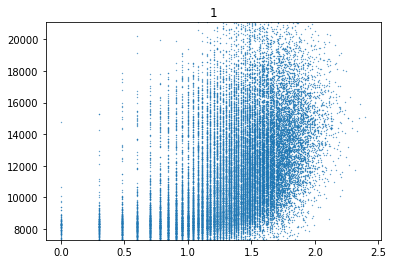


spearman 0.5681
pearson 0.389


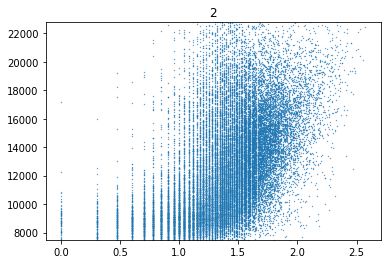


spearman 0.1934
pearson 0.304


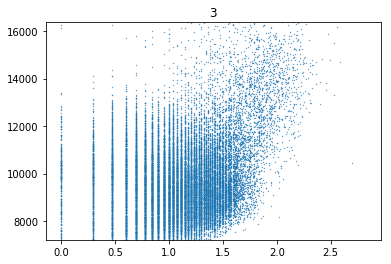


spearman 0.4847
pearson 0.3607


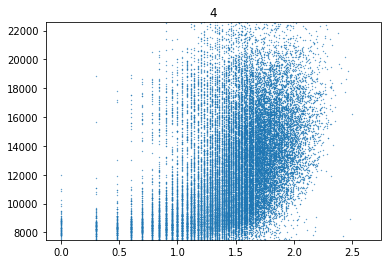


spearman 0.6567
pearson 0.5404


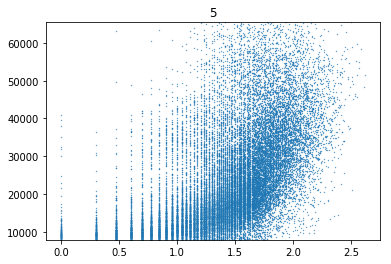


spearman 0.3998
pearson 0.2726


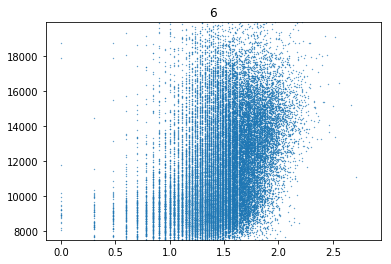


spearman 0.5224
pearson 0.3515


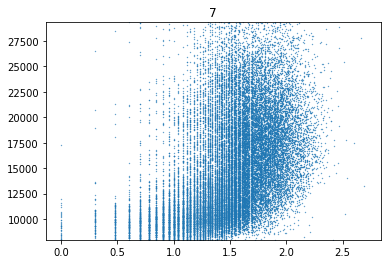


spearman 0.2349
pearson 0.1594


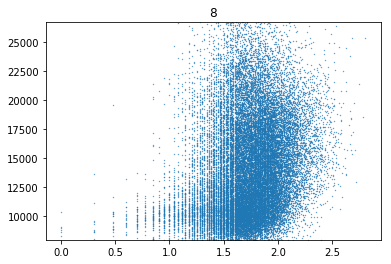


spearman 0.6925
pearson 0.5559


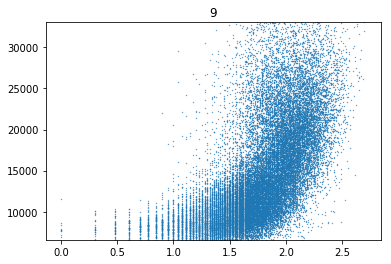


spearman 0.4889
pearson 0.3642


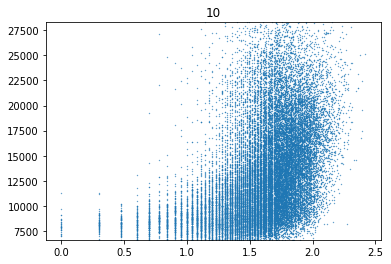


spearman 0.3335
pearson 0.2208


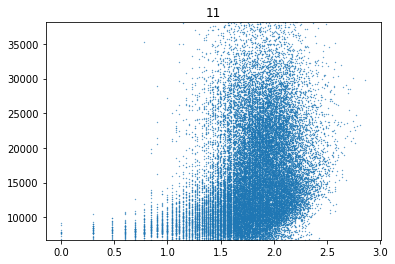


spearman 0.5837
pearson 0.4432


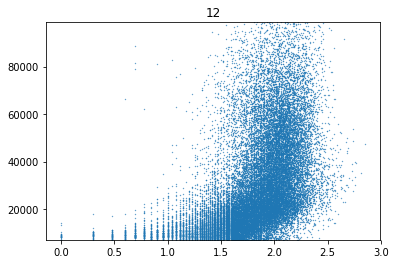


spearman 0.2512
pearson 0.1444


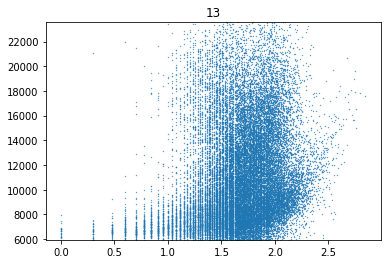


spearman 0.3472
pearson 0.3914


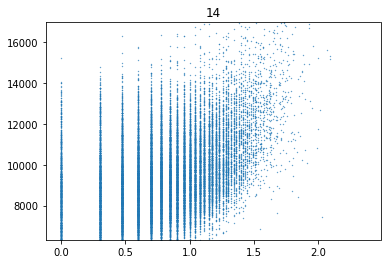


spearman 0.5994
pearson 0.4313


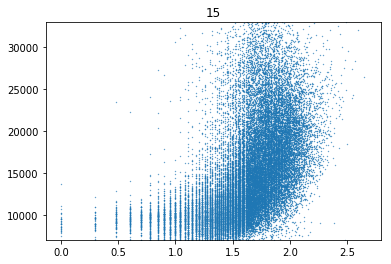


spearman 0.3162
pearson 0.2174


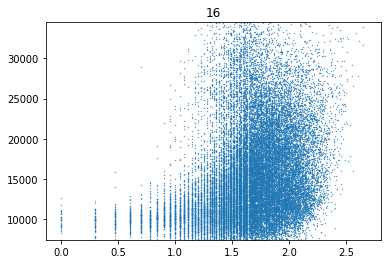


spearman 0.4107
pearson 0.3283


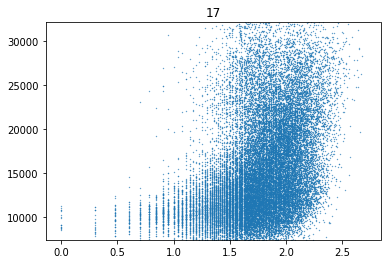

In [42]:
cell_counts_df = pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/cell_counts_df.csv.gz',index_col=0)
compressed_df = compressed_df2.sort_index()
cell_counts_df = cell_counts_df.sort_index()
# nuclear_intensity = intensity_df['nuclear intensity']
spot_sum = np.sum(cell_counts_df,axis=1)
for i in compressed_df.columns:
    intensities = compressed_df[i]#/nuclear_intensity
    temp_gene_col = list(binary_df[binary_df[i]==1].index)
    counts = np.sum(cell_counts_df[temp_gene_col],axis=1)#/spot_sum
    print('')
    print('spearman',round(spearmanr(intensities,counts)[0],4))
    print('pearson',round(pearsonr(intensities,counts)[0],4))
    plt.scatter(np.log10(counts),intensities,s=0.1)
    plt.ylim([np.percentile(intensities,1),np.percentile(intensities,99)])
    plt.title(i)
    plt.show()